In [1]:
#filename = '/exp/dune/app/users/mking/dunesw_v09_82_00d00/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/Waveforms.root'
filename = '/exp/dune/data/users/mking/ICEBERG_Data/Waveforms_Data_Run_9701.root'
import uproot
import numpy as np
import matplotlib.pyplot as plt

file = uproot.open(filename)
print(file.keys())

['run_9701_sub_1_event_1_daq;1', 'run_9701_sub_1_event_3_daq;1', 'run_9701_sub_1_event_5_daq;1', 'run_9701_sub_1_event_7_daq;1', 'run_9701_sub_1_event_9_daq;1', 'run_9701_sub_1_event_11_daq;1', 'run_9701_sub_1_event_13_daq;1', 'run_9701_sub_1_event_15_daq;1', 'run_9701_sub_1_event_17_daq;1', 'run_9701_sub_1_event_19_daq;1', 'run_9701_sub_1_event_21_daq;1', 'run_9701_sub_1_event_23_daq;1', 'run_9701_sub_1_event_25_daq;1', 'run_9701_sub_1_event_27_daq;1', 'run_9701_sub_1_event_29_daq;1', 'run_9701_sub_1_event_31_daq;1', 'run_9701_sub_1_event_33_daq;1', 'run_9701_sub_1_event_35_daq;1', 'run_9701_sub_1_event_37_daq;1', 'run_9701_sub_1_event_39_daq;1', 'run_9701_sub_1_event_41_daq;1', 'run_9701_sub_1_event_43_daq;1', 'run_9701_sub_1_event_45_daq;1', 'run_9701_sub_1_event_47_daq;1', 'run_9701_sub_1_event_49_daq;1', 'run_9701_sub_1_event_51_daq;1', 'run_9701_sub_1_event_53_daq;1', 'run_9701_sub_1_event_55_daq;1', 'run_9701_sub_1_event_57_daq;1', 'run_9701_sub_1_event_59_daq;1', 'run_9701_sub_

In [7]:
print(file['run_1_sub_0_event_1_daq;1'])

<TH2F (version 4) at 0x7fe79abd6c40>


In [13]:
H, xedges, yedges = file['run_9701_sub_1_event_1_daq;1'].to_numpy()

In [21]:
print(np.shape(H))
print(np.shape(H)[0])
print(np.shape(xedges))
print(np.shape(yedges))

(1280, 2128)
1280
(1281,)
(2129,)


In [14]:
xcenters = (xedges[:-1] + xedges[1:]) / 2
timeticks = yedges[:-1]

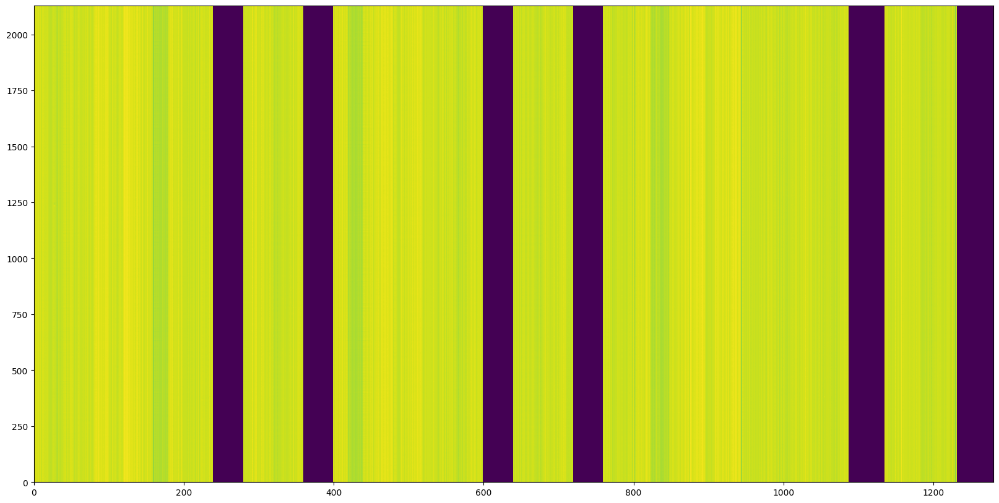

In [17]:
import matplotlib.pyplot as plt

#fig,ax = plt.subplots(1)
#pc = ax.pcolorfast(xedges,yedges,H)
#plt.show()

fig2,ax2 = plt.subplots(1,figsize=(20,10))
pc2 = ax2.pcolorfast(xedges,yedges,H.T)
#plt.xlim(2080,2105)
#plt.ylim(1140,1220)
plt.show()

In [20]:
print(H[1000][2120:2128])
print(H[1000][])

[8904. 8900. 8892. 8892. 8891. 8895. 8899.    0.]


8894.15
193.01083


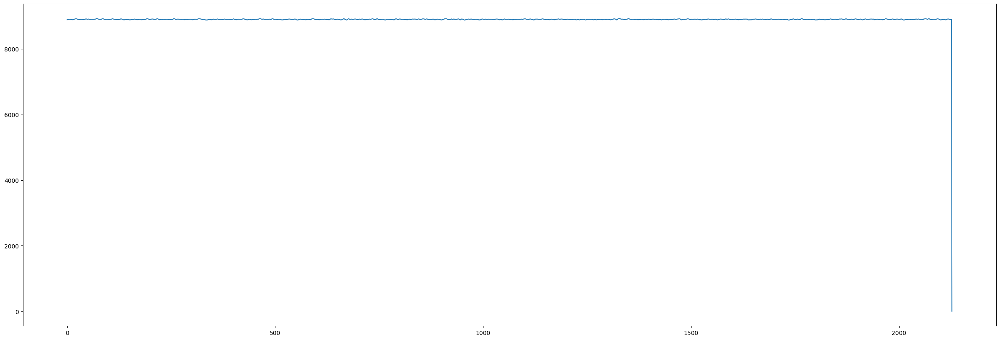

In [18]:
plt.figure(figsize = (30,10))
plt.plot(timeticks,H[1000])
print(np.mean(H[1000]))
print(np.std(H[1000]))

In [23]:
#Baseline subtract
# Should go up to 2128
# For run 9701, the last entry is zeroed out, so we disallow it from the mean calculation when baseline subtracting
H_subtr = H - np.mean(H[:,0:2127],axis=1)[:,np.newaxis]
H_subtr[:,2127] = np.zeros(1280)

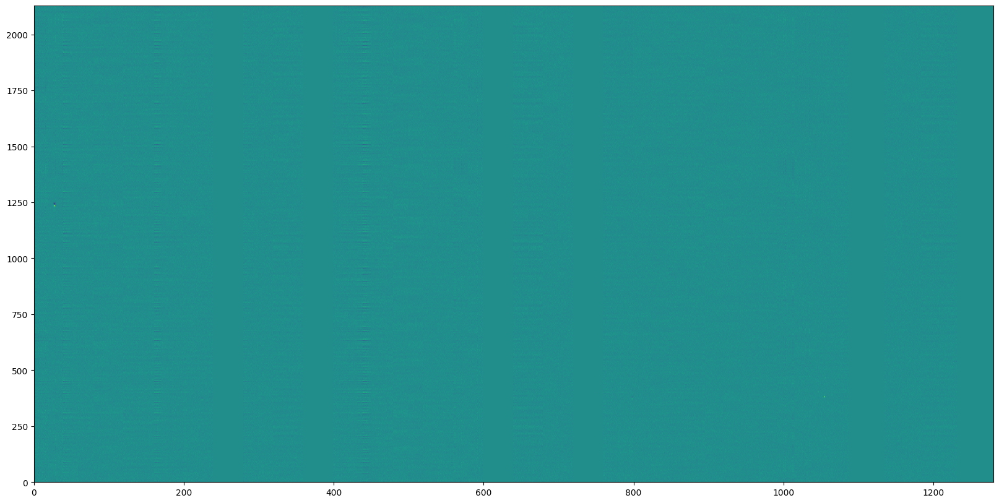

In [25]:
fig2,ax2 = plt.subplots(1,figsize=(20,10))
pc2 = ax2.pcolorfast(xedges,yedges,H_subtr.T)
#plt.xlim(2080,2105)
#plt.ylim(1140,1220)
plt.show()

-0.0014978853
193.01083


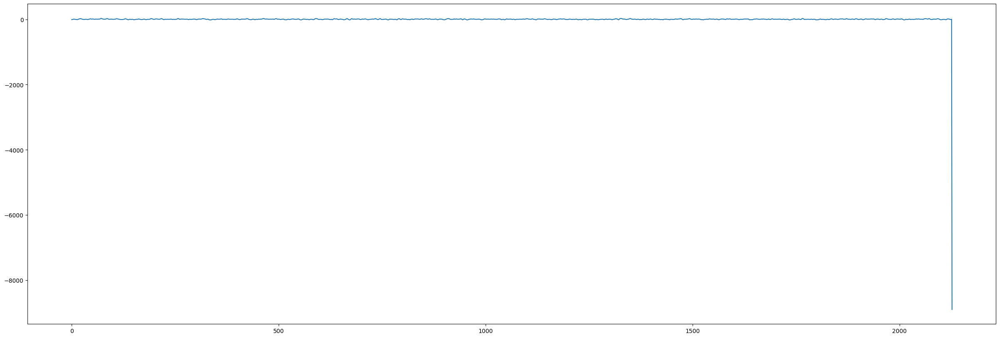

In [6]:
plt.figure(figsize = (30,10))
plt.plot(timeticks,H_subtr[1000])
print(np.mean(H_subtr[1000]))
print(np.std(H_subtr[1000]))

In [2]:
## Validate the FFTs
from Analyzer import Analyzer
import numpy as np
H, xedges, yedges, xcenters, timeticks, key = Analyzer.LoadWaveformFile(Waveform_File_Path='Waveforms_Sim_50.root')
H_subtr = H - np.mean(H[:,0:2128],axis=1)[:,np.newaxis]

In [3]:
import numpy as np

In [3]:
print(np.shape(H))

(1280, 2128)


In [4]:
FFT = Analyzer.FFTEventFast(H_subtr,key)

In [7]:
print(np.shape(FFT))
print(np.shape(FFT[0]))
print(np.shape(FFT[:,0]))

(1280, 1065)
(1065,)
(1280,)


In [18]:
from Analyzer import Analyzer
import numpy as np
datapath = '/exp/dune/data/users/mking/'
inputwaveformlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/05_15_2024_2/'
inputfilename = 'Waveforms_Sim.root'
outputfftlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/Sim_50_Plots_3/'
outputfilename = 'AverageFFT.npz'



#AverageFFT = Analyzer.AverageFFT(OutputFFT_File_Path = datapath+outputfftlocation+outputfilename, Waveform_File_Path=datapath + inputwaveformlocation + inputfilename,nEvents = 50)

The history saving thread hit an unexpected error (OperationalError('disk I/O error')).History will not be written to the database.


In [2]:
## Validate a single FFT
H, xedges, yedges, xcenters, timeticks, key = Analyzer.LoadWaveformFile(Waveform_File_Path=datapath+inputwaveformlocation+inputfilename)
H_subtr = H - np.mean(H[:,0:2128],axis=1)[:,np.newaxis]

In [3]:
FFT = np.abs(np.fft.rfft(H_subtr))

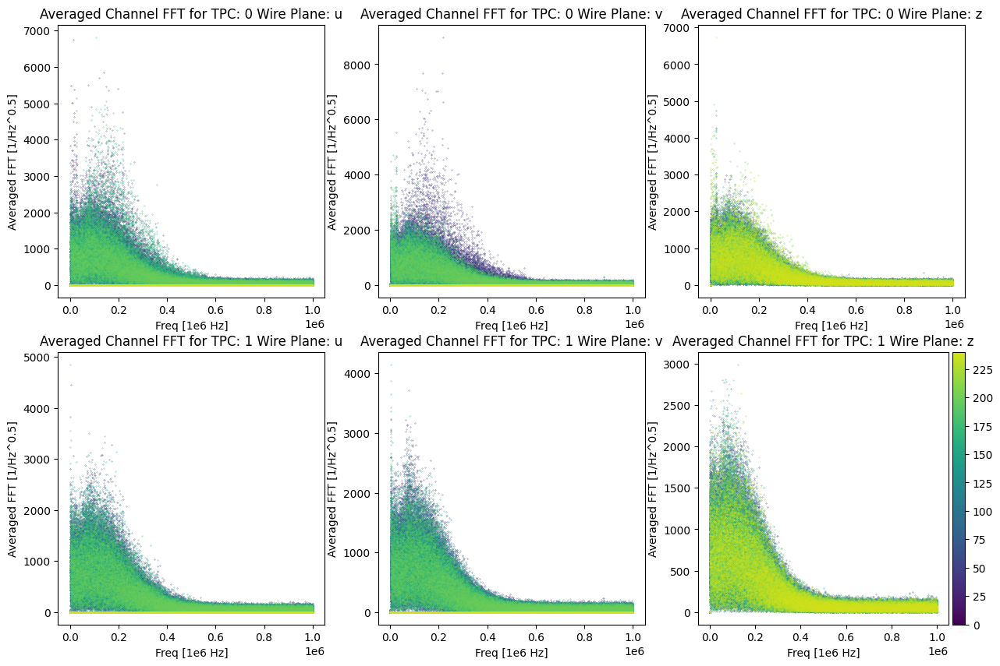

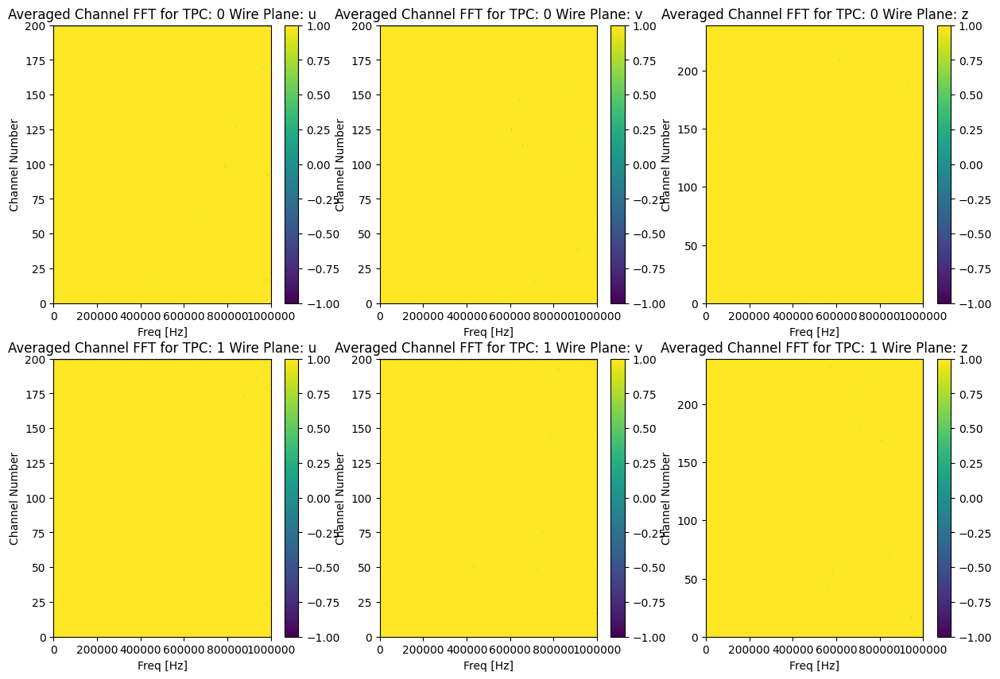

In [5]:
from plotter import plotter
plotter.HistAvgPSDbyPlane(FFT,outputFile1 = 'histFFT_sim_single.png',outputFile2 = 'FFT_sim_single.png')

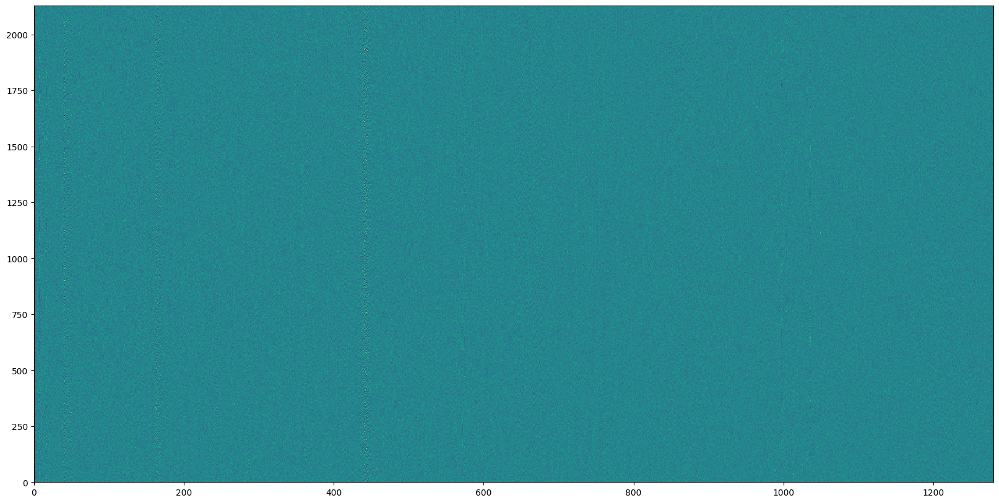

In [7]:
import matplotlib.pyplot as plt
fig2,ax2 = plt.subplots(1,figsize=(20,10))
pc2 = ax2.pcolorfast(xedges,yedges,H_subtr.T)
#plt.xlim(2080,2105)
#plt.ylim(1140,1220)
fig2.savefig("Single_Sim_Waveform_Unsorted", dpi = fig2.dpi)
plt.show()

In [4]:
from Analyzer import Analyzer
import numpy as np
import uproot as uproot

datapath = '/exp/dune/data/users/mking/'
inputwaveformlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/07_10_2024/'
inputfilename = 'Waveforms_Sim.root'
outputfftlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/Sim_Full_Plots/'
outputfilename = 'AverageFFT.npz'

Waveform_File_Path = datapath + inputwaveformlocation + inputfilename

infile = uproot.open(Waveform_File_Path)
print(infile.keys())
print(np.shape(infile.keys()))
    

['run_1_sub_0_event_1_daq;1', 'run_1_sub_0_event_1_sig;1', 'run_1_sub_0_event_2_daq;1', 'run_1_sub_0_event_2_sig;1', 'run_1_sub_0_event_3_daq;1', 'run_1_sub_0_event_3_sig;1', 'run_1_sub_0_event_4_daq;1', 'run_1_sub_0_event_4_sig;1', 'run_1_sub_0_event_5_daq;1', 'run_1_sub_0_event_5_sig;1', 'run_1_sub_0_event_6_daq;1', 'run_1_sub_0_event_6_sig;1', 'run_1_sub_0_event_7_daq;1', 'run_1_sub_0_event_7_sig;1', 'run_1_sub_0_event_8_daq;1', 'run_1_sub_0_event_8_sig;1', 'run_1_sub_0_event_9_daq;1', 'run_1_sub_0_event_9_sig;1', 'run_1_sub_0_event_10_daq;1', 'run_1_sub_0_event_10_sig;1', 'run_1_sub_0_event_11_daq;1', 'run_1_sub_0_event_11_sig;1', 'run_1_sub_0_event_12_daq;1', 'run_1_sub_0_event_12_sig;1', 'run_1_sub_0_event_13_daq;1', 'run_1_sub_0_event_13_sig;1', 'run_1_sub_0_event_14_daq;1', 'run_1_sub_0_event_14_sig;1', 'run_1_sub_0_event_15_daq;1', 'run_1_sub_0_event_15_sig;1', 'run_1_sub_0_event_16_daq;1', 'run_1_sub_0_event_16_sig;1', 'run_1_sub_0_event_17_daq;1', 'run_1_sub_0_event_17_sig;1

In [5]:
from Analyzer import Analyzer
import numpy as np
AverageFFT = Analyzer.AverageFFT(OutputFFT_File_Path = datapath+outputfftlocation+outputfilename, Waveform_File_Path=datapath + inputwaveformlocation + inputfilename,nEvents = 1393)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [1]:
import numpy as np
AverageFFT = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/Sim_Full_Plots/AverageFFT.npz')['FFT']

The history saving thread hit an unexpected error (OperationalError('disk I/O error')).History will not be written to the database.
(1281,)
(1066,)
(1280, 1065)


/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/ICEBERG_Noise_Modeling/src/Analyzer.py:201: RuntimeWarning: divide by zero encountered in log10
  ax.pcolormesh(channel_edges,freq_edges,np.log10(FFT).T,cmap = cmap,shading='flat',vmin = -1, vmax = 7) #default -1,7
/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/ICEBERG_Noise_Modeling/src/Analyzer.py:202: RuntimeWarning: divide by zero encountered in log10
  fig.colorbar(ax.pcolormesh(channel_edges,freq_edges,np.log10(FFT).T,cmap = cmap,shading='flat',vmin = -1, vmax = 7) ) #default -1,7


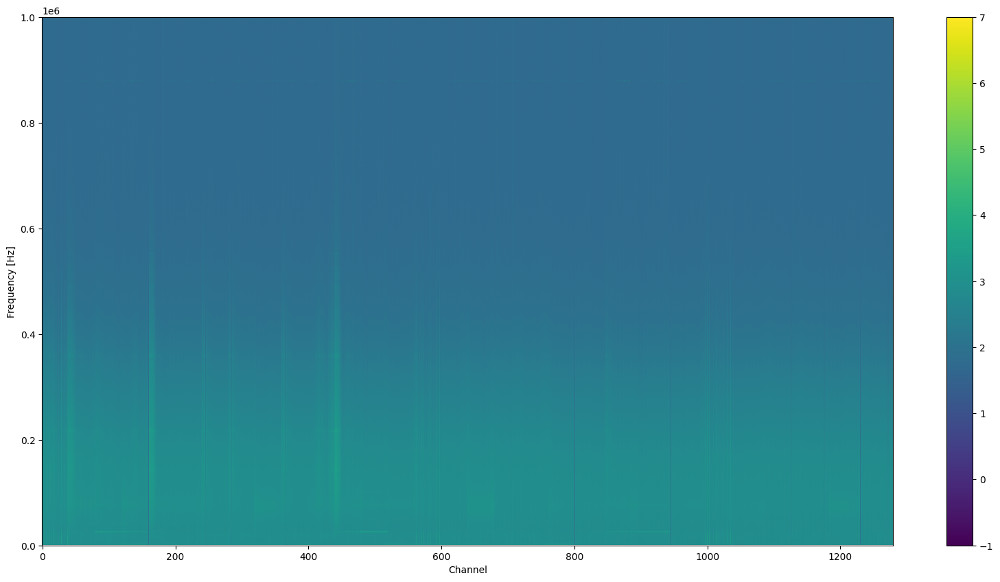

In [6]:
from Analyzer import Analyzer
Analyzer.Plot2DFFT(AverageFFT)

/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/ICEBERG_Noise_Modeling/src/plotter.py:135: RuntimeWarning: divide by zero encountered in log10
  ax2[tpc][plane].pcolormesh(freq,range(plotter.maxwires),np.log10(Sorted_PSD[tpc][plane]),cmap = cmap,shading='gouraud',vmin = 1.3, vmax = 3.3) #default 1.3,3.3
/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/ICEBERG_Noise_Modeling/src/plotter.py:136: RuntimeWarning: divide by zero encountered in log10
  fig2.colorbar(ax2[tpc][plane].pcolormesh(freq,range(plotter.maxwires),np.log10(Sorted_PSD[tpc][plane]),cmap = cmap,shading='gouraud',vmin =1.3, vmax = 3.3)) #default 1.3,3.3


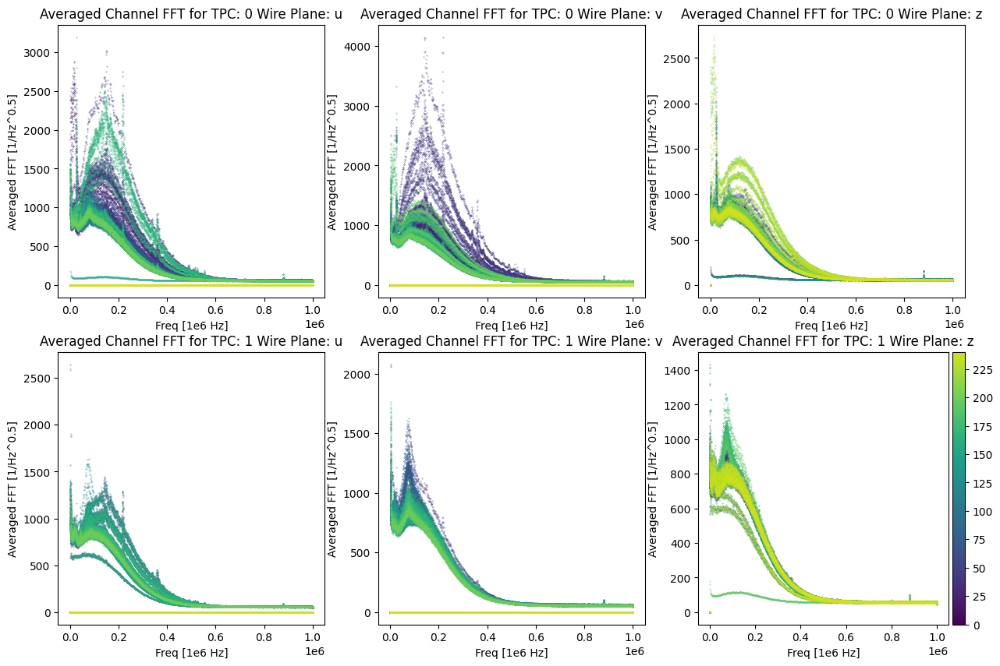

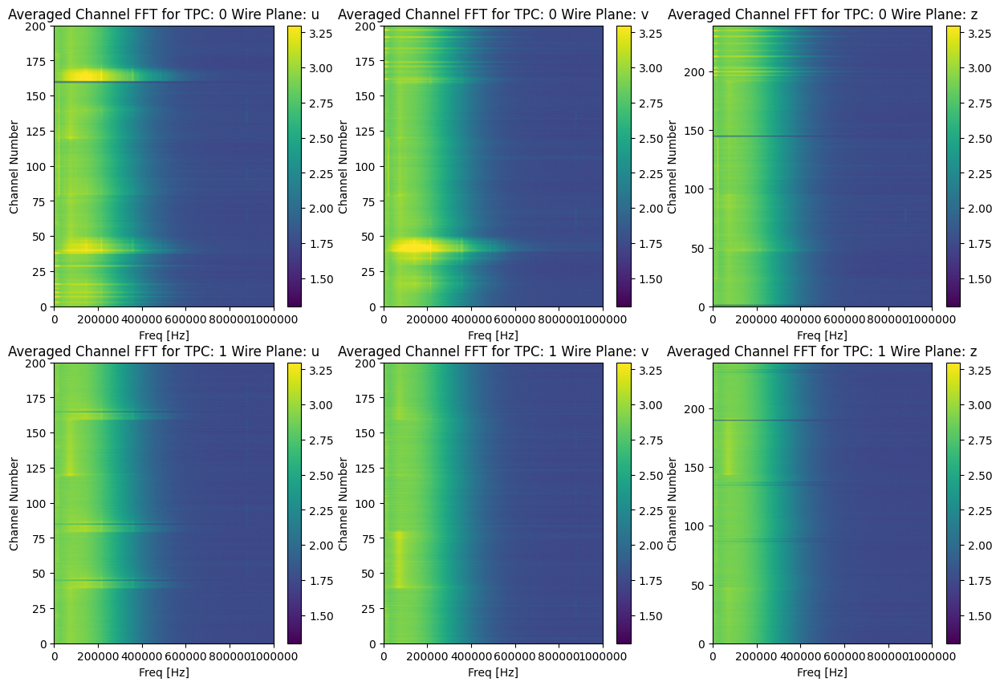

In [2]:
from plotter import plotter
plotter.HistAvgPSDbyPlane(AverageFFT)

In [6]:
## Now for data...
from Analyzer import Analyzer
import numpy as np
AverageFFT = Analyzer.AverageFFT(OutputFFT_File_Path = 'AverageFFT.npz', Waveform_File_Path='Waveforms_Data.root',nEvents = 50)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


In [1]:
import numpy as np
AverageFFT = np.load('AverageFFT.npz')['FFT']

/exp/dune/app/users/mking/dunesw_v09_82_00d00/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/plotter.py:115: RuntimeWarning: divide by zero encountered in log10
  ax2[tpc][plane].pcolormesh(freq,range(plotter.maxwires),np.log10(Sorted_PSD[tpc][plane]),cmap = cmap,shading='gouraud',vmin = 3.5, vmax = 4.5) #default -14,-5
/exp/dune/app/users/mking/dunesw_v09_82_00d00/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/plotter.py:116: RuntimeWarning: divide by zero encountered in log10
  fig2.colorbar(ax2[tpc][plane].pcolormesh(freq,range(plotter.maxwires),np.log10(Sorted_PSD[tpc][plane]),cmap = cmap,shading='gouraud',vmin = 3.5, vmax = 4.5)) #default -14,-5


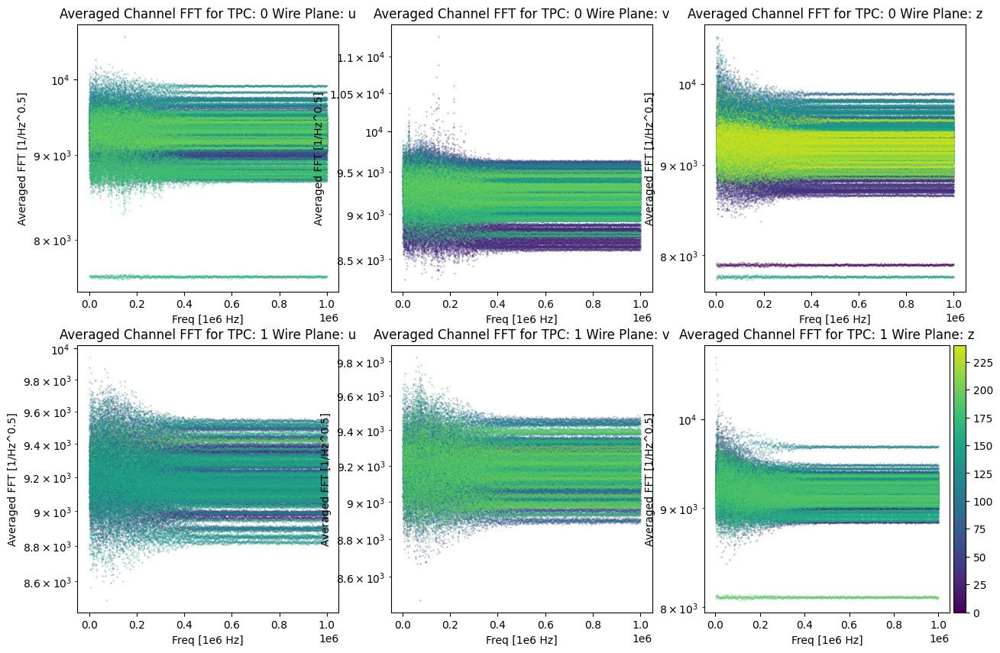

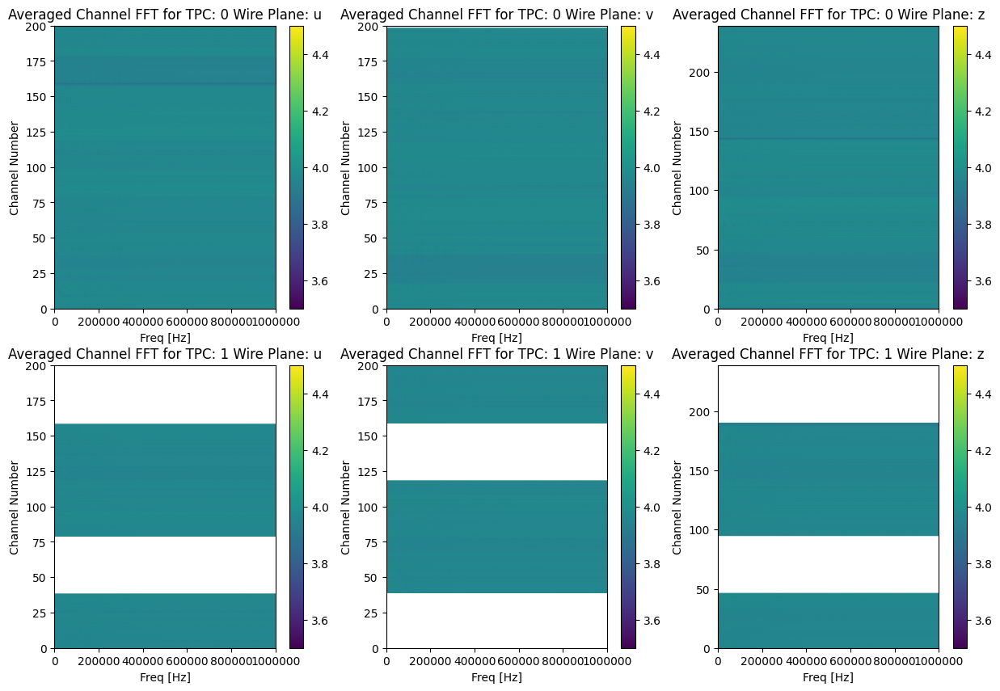

In [2]:
from plotter import plotter
plotter.HistAvgPSDbyPlane(AverageFFT)

In [3]:
#Plots to compare data and simulation
DataAverageFFT = np.load('./Data_50_Plots/AverageFFT_Data.npz')['FFT']
SimAverageFFT = np.load('./Sim_50_Plots/AverageFFT.npz')['FFT']

FileNotFoundError: [Errno 2] No such file or directory: 'Data_50_Plots/AverageFFT_Data.npz'

In [6]:
### Load and plot the full data noise model FFT
from Analyzer import Analyzer
from plotter import plotter
import numpy as np

datapath = '/exp/dune/data/users/mking/'
inputwaveformlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/05_15_2024/'
inputfilename = 'Waveforms_Sim.root'
outputfftlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/Data_Full_Plots/'

NoiseModel = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/Data_Full_Plots/NoiseModel_FFT_05_15_2024.npz')
FFT = NoiseModel['PSD']



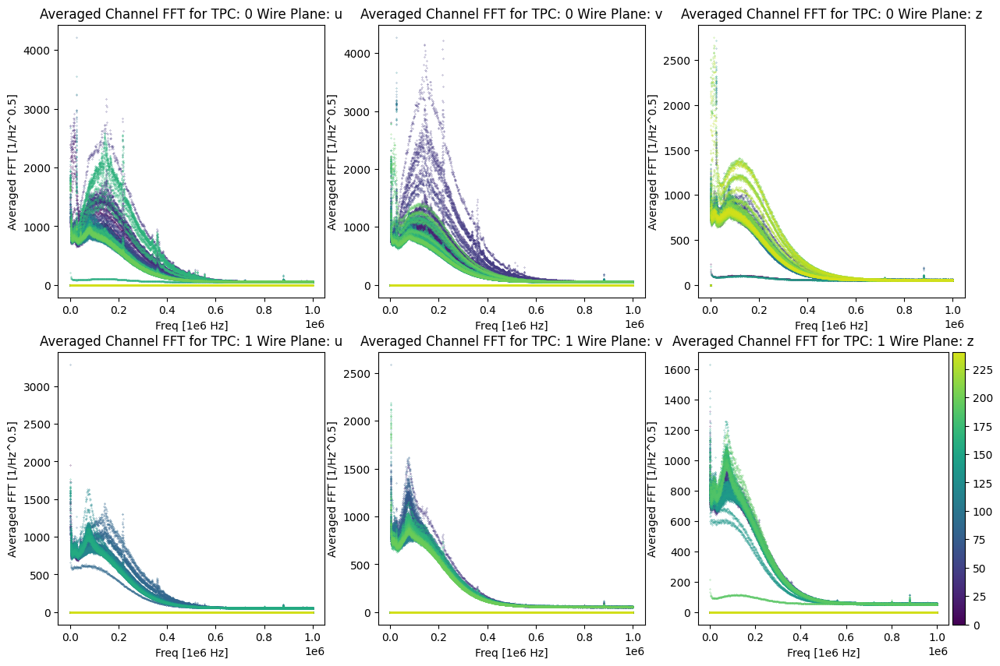

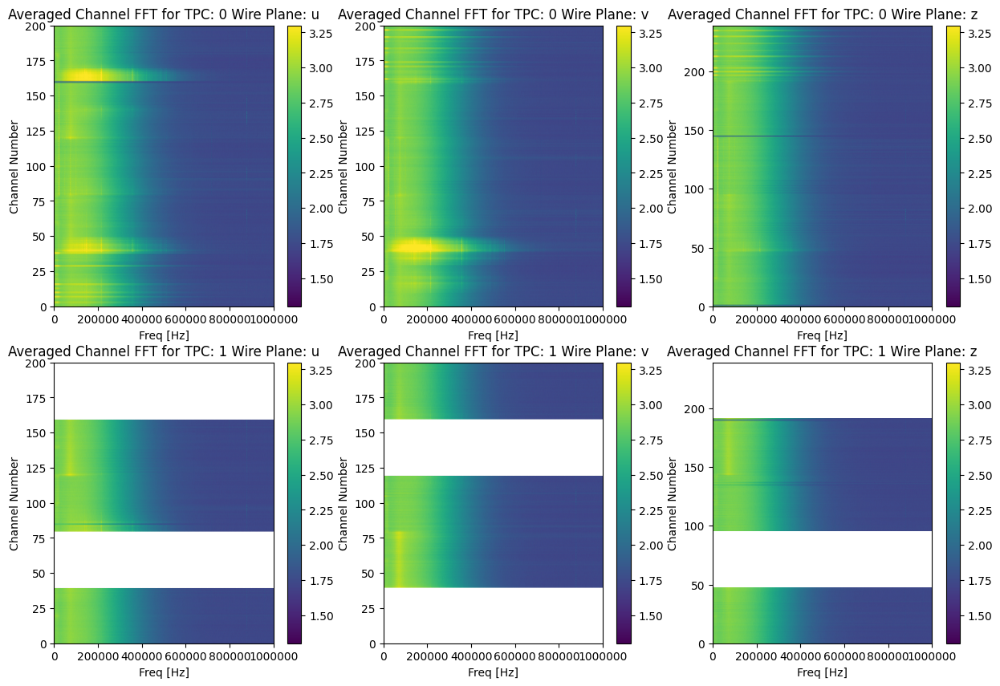

In [4]:
plotter.HistAvgPSDbyPlane(FFT)

In [1]:
### Load and plot the full data noise model FFT
from Analyzer import Analyzer
from plotter import plotter
import numpy as np

##compare the data and simulation FFTs
AverageFFT = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/Sim_Full_Plots/AverageFFT.npz')['FFT']
#FFT is the data FFT from the previous cell

NoiseModel = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/Data_Full_Plots/NoiseModel_FFT_05_15_2024.npz')
FFT = NoiseModel['PSD']

In [ ]:
##Fill in Missing sections in Data FFT
FFT[240:280] = FFT[280:320]     #FEMB 9 u1 = FEMB 8 u1
FFT[360:400] = FFT[280:320]     #FEMB 6 u1 = FEMB 8 u1
FFT[600:640] = FFT[680:720]     #FEMB 6 v1 = FEMB 8 v1
FFT[720:760] = FFT[680:720]     #FEMB 9 v1 = FEMB 8 v1
FFT[1088:1136] = FFT[1136:1184] #FEMB 9 z1 = FEMB 8 z1
FFT[1232:1280] = FFT[1136:1184] #FEMB 6 z1 = FEMB 8 z1

In [2]:
##Zero out the missing sections in the simulation FFT
AverageFFT[240:280] = np.zeros((40,Analyzer.PSDlength),dtype=float)
AverageFFT[360:400] = np.zeros((40,Analyzer.PSDlength),dtype=float)
AverageFFT[600:640] = np.zeros((40,Analyzer.PSDlength),dtype=float)
AverageFFT[720:760] = np.zeros((40,Analyzer.PSDlength),dtype=float)
AverageFFT[1088:1136] = np.zeros((48,Analyzer.PSDlength),dtype=float)
AverageFFT[1232:1280] = np.zeros((48,Analyzer.PSDlength),dtype=float)

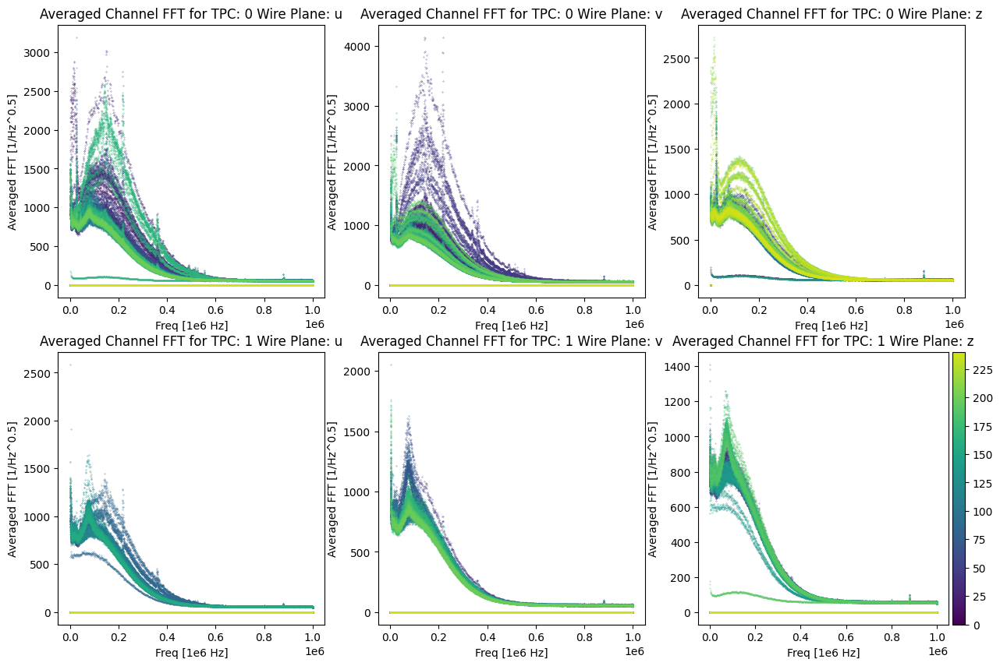

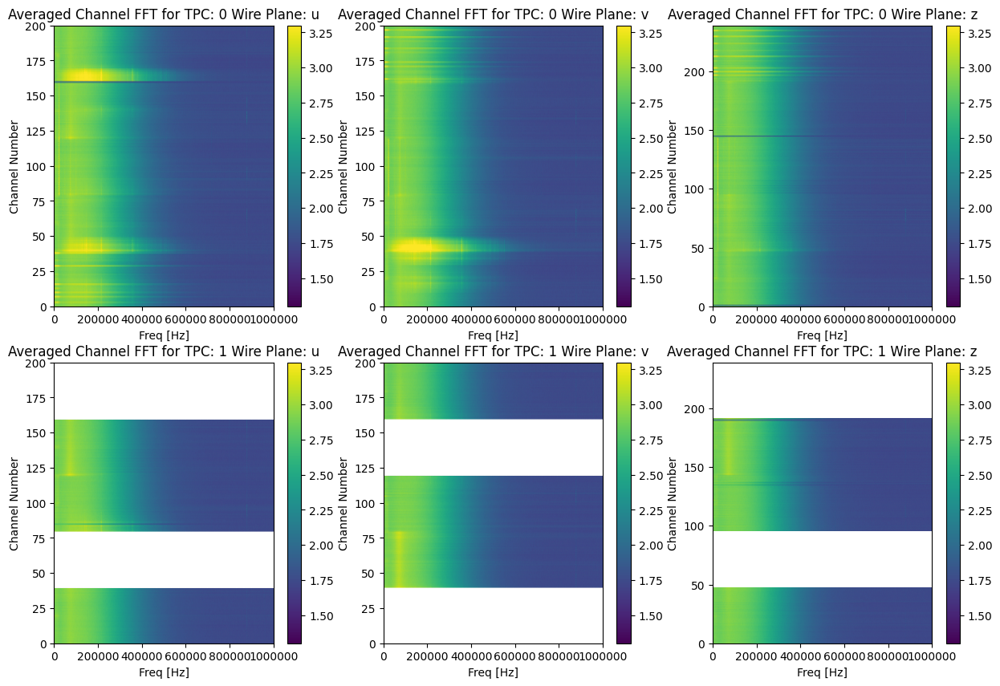

In [5]:
plotter.HistAvgPSDbyPlane(AverageFFT)

/tmp/ipykernel_2061260/1801722894.py:3: RuntimeWarning: invalid value encountered in divide
  FractionalDifference = (FFT - AverageFFT)/FFT


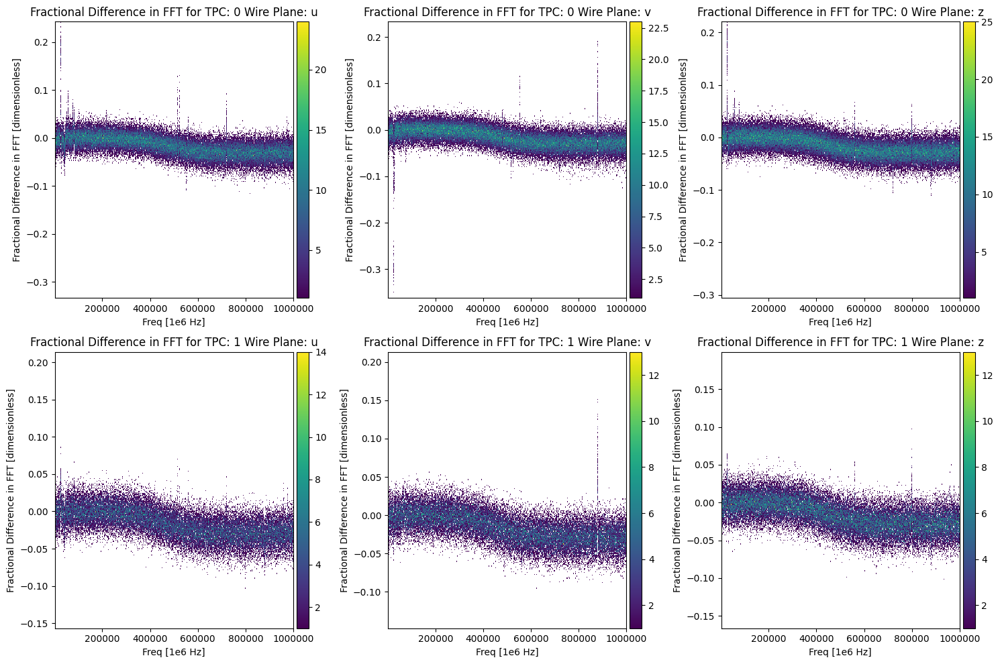

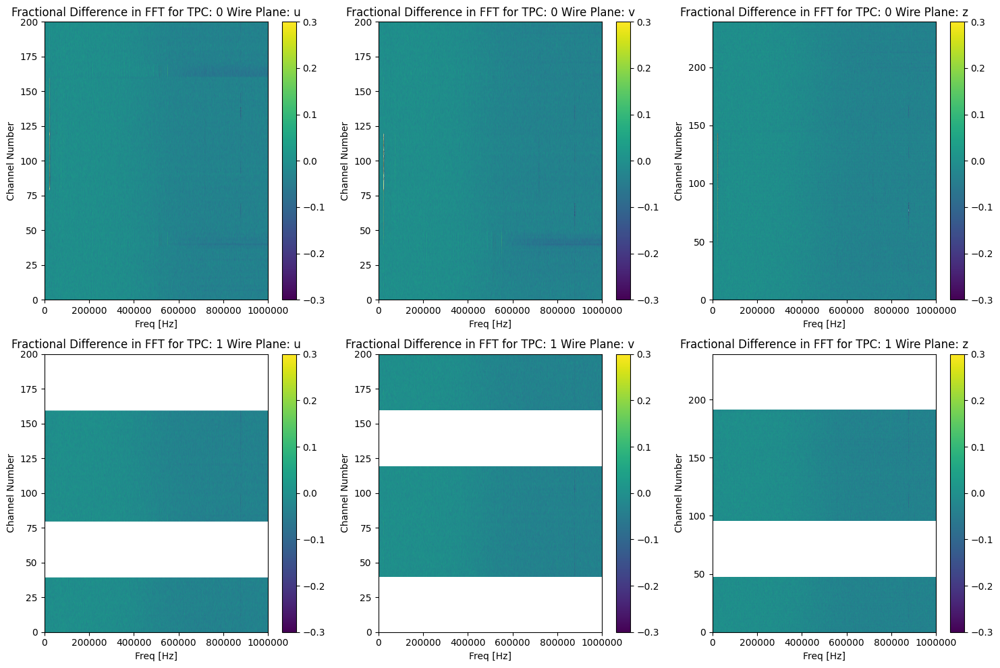

In [3]:
#plotter.HistAvgPSDbyPlane((FFT - AverageFFT)/FFT)

FractionalDifference = (FFT - AverageFFT)/FFT

plotter.Hist2DFuncByPlane(FractionalDifference,outputFile1 = 'FractionalDiffHisto.png',outputFile2 = 'FractionalDiff2D.png',logmode = False, maxval = 0.3, minval = -0.3,funclabel = "Fractional Difference in FFT",units = "dimensionless")

In [5]:
FractionalDifference = (FFT - AverageFFT)/FFT
#Delete first column of this array because it's all zeros
FractionalDifference = FractionalDifference[:,1:]

#Delete nan rows:
FractionalDifference = FractionalDifference[~np.isnan(FractionalDifference).all(axis=1)]

#Print number of remaining rows
print(np.shape(FractionalDifference))

(1024, 1064)


/tmp/ipykernel_2061260/352209621.py:1: RuntimeWarning: invalid value encountered in divide
  FractionalDifference = (FFT - AverageFFT)/FFT


In [7]:
NumActiveChannels = np.shape(FractionalDifference)[0]

## Count "Good channels" and "Bad channels"
#Define MostlyGood Channel as one where Fractional FFT difference is within 15% at > 90% of frequencies
#Define Very Good Channel as one where Fractional FFT difference is within 25% at all frequencies - nothing within 20% at every value
#Define Good channel as one where fractional FFT difference is within 30% at all frequencies
#OK channel has fractional FFT difference within 40% of frequencies
#Define Bad channel as one where fractional FFT difference is > 30% at any frequency
#Define Very Bad channel as one where fractional FFT difference is > 40% at any frequency
#Perfect channel is one where fractional FFT difference is 0 at all frequencies

MostlyGoodChannels = np.zeros(NumActiveChannels,dtype=int)
VeryGoodChannels = np.zeros(NumActiveChannels,dtype=int)
GoodChannels = np.zeros(NumActiveChannels,dtype=int)
OKChannels = np.zeros(NumActiveChannels,dtype=int)
BadChannels = np.zeros(NumActiveChannels,dtype=int)
VeryBadChannels = np.zeros(NumActiveChannels,dtype=int)
PerfectChannels = np.zeros(NumActiveChannels,dtype=int)


for i in range(NumActiveChannels):
    #Mostly Good Channels
    if np.nansum(np.abs(FractionalDifference[i]) < 0.15) > 0.90*len(FractionalDifference[i]):
        MostlyGoodChannels[i] = 1
    if np.all(np.abs(FractionalDifference[i]) < 0.25):
        VeryGoodChannels[i] = 1
    if np.all(np.abs(FractionalDifference[i]) < 0.3):
        GoodChannels[i] = 1
    if np.all(np.abs(FractionalDifference[i]) < 0.4):
        OKChannels[i] = 1
    if np.any(np.abs(FractionalDifference[i]) > 0.3):
        BadChannels[i] = 1
    if np.any(np.abs(FractionalDifference[i]) > 0.4):
        VeryBadChannels[i] = 1
    #Perfect Channels
    if np.all(np.abs(FractionalDifference[i]) == 0):
        PerfectChannels[i] = 1

NumMostlyGoodChannels = np.sum(MostlyGoodChannels)
NumVeryGoodChannels = np.sum(VeryGoodChannels)
NumGoodChannels = np.sum(GoodChannels)
NumOKChannels = np.sum(OKChannels)
NumBadChannels = np.sum(BadChannels)
NumVeryBadChannels = np.sum(VeryBadChannels)
NumPerfectChannels = np.sum(PerfectChannels)

print("NumMostlyGoodChannels "+str(NumMostlyGoodChannels))
print("NumVeryGoodChannels "+str(NumVeryGoodChannels))
print("NumGoodChannels "+str(NumGoodChannels))
print("NumOKChannels "+str(NumOKChannels))
print("NumBadChannels "+str(NumBadChannels))
print("NumVeryBadChannels "+str(NumVeryBadChannels))
print("NumPerfectChannels "+str(NumPerfectChannels))



NumMostlyGoodChannels 1024
NumVeryGoodChannels 953
NumGoodChannels 988
NumOKChannels 1024
NumBadChannels 36
NumVeryBadChannels 0
NumPerfectChannels 0


In [8]:
print("NumMostlyGoodChannels "+str(NumMostlyGoodChannels)+' '+str(NumMostlyGoodChannels/NumActiveChannels))
print("NumVeryGoodChannels "+str(NumVeryGoodChannels)+' '+str(NumVeryGoodChannels/NumActiveChannels))
print("NumGoodChannels "+str(NumGoodChannels)+' '+str(NumGoodChannels/NumActiveChannels))
print("NumOKChannels "+str(NumOKChannels)+' '+str(NumOKChannels/NumActiveChannels))
print("NumBadChannels "+str(NumBadChannels)+' '+str(NumBadChannels/NumActiveChannels))
print("NumVeryBadChannels "+str(NumVeryBadChannels)+' '+str(NumVeryBadChannels/NumActiveChannels))
print("NumPerfectChannels "+str(NumPerfectChannels)+' '+str(NumPerfectChannels/NumActiveChannels))

NumMostlyGoodChannels 1024 1.0
NumVeryGoodChannels 953 0.9306640625
NumGoodChannels 988 0.96484375
NumOKChannels 1024 1.0
NumBadChannels 36 0.03515625
NumVeryBadChannels 0 0.0
NumPerfectChannels 0 0.0


/tmp/ipykernel_998748/2743212618.py:3: RuntimeWarning: invalid value encountered in divide
  FractionalDifference = (FFT - AverageFFT)/FFT


Text(0, 0.5, 'Fractional Difference')

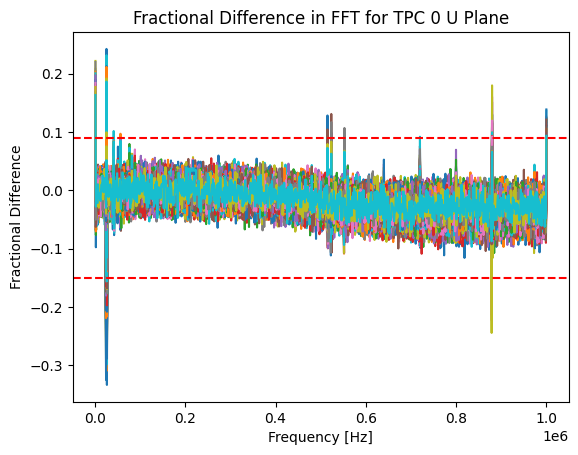

In [34]:
import matplotlib.pyplot as plt

FractionalDifference = (FFT - AverageFFT)/FFT
FractionalDifference = FractionalDifference[:,1:]

plt.figure()
for i in range(200):
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing)[1:],plotter.convert_to_sorted(FractionalDifference)[0][0][i],label=i)

#plot dotted horizontal lines at +/- 0.1
plt.axhline(y=0.09, color='r', linestyle='--')
plt.axhline(y=-0.15, color='r', linestyle='--')

plt.title("Fractional Difference in FFT for TPC 0 U Plane")
plt.xlabel("Frequency [Hz]")
plt.ylabel("Fractional Difference")

#plt.legend()

In [35]:
## Create a list of problem frequencies and problem channels where the fractional difference is greater than 0.1
#The List is a list of tuples, where each tuple is (channel number, frequency)
ProblemChannels = []
for i in range(1280):
    ProblemFrequenciesList = []
    for j in range(Analyzer.PSDlength-1):
        if np.abs(FractionalDifference[i][j]) > 0.09 or np.abs(FractionalDifference[i][j]) < -0.15:
            ProblemFrequenciesList.append(j)
    if len(ProblemFrequenciesList)>0: ProblemChannels.append([i,ProblemFrequenciesList])

In [25]:
print(ProblemChannels[1])
print(ProblemChannels[1][1])

[1, [0]]
[0]


In [36]:
#For each problem frequency, make a list of the channels that have a problem at that frequency
ProblemFrequencies = []
for i in range(Analyzer.PSDlength-1):
    ProblemChannelsList = []
    for j in range(len(ProblemChannels)):
        if i in ProblemChannels[j][1]:
            ProblemChannelsList.append(ProblemChannels[j][0])
    if len(ProblemChannelsList)>0: ProblemFrequencies.append([i,ProblemChannelsList])



In [37]:
print(ProblemFrequencies)
print(ProblemChannels)

[[0, [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220,

[[0, 1024], [1, 7], [2, 1], [24, 6], [25, 239], [26, 261], [27, 243], [28, 39], [43, 1], [59, 2], [80, 1], [513, 1], [547, 12], [548, 11], [555, 9], [556, 6], [557, 1], [559, 2], [586, 17], [587, 11], [589, 1], [596, 1], [608, 1], [640, 1], [642, 1], [645, 1], [647, 1], [662, 1], [667, 1], [672, 1], [688, 1], [689, 1], [690, 1], [691, 1], [704, 1], [712, 1], [714, 1], [717, 1], [721, 1], [730, 1], [732, 1], [741, 1], [742, 1], [752, 1], [755, 1], [757, 1], [763, 1], [764, 6], [765, 6], [766, 13], [768, 1], [769, 1], [770, 1], [773, 1], [777, 1], [782, 1], [787, 1], [793, 1], [795, 1], [796, 1], [797, 1], [798, 3], [801, 1], [803, 1], [808, 2], [809, 1], [812, 3], [813, 1], [815, 2], [817, 1], [821, 1], [822, 1], [823, 1], [824, 1], [826, 2], [828, 1], [831, 1], [833, 2], [834, 1], [835, 1], [837, 1], [841, 1], [843, 2], [846, 2], [848, 1], [849, 4], [850, 2], [851, 4], [852, 1], [853, 2], [854, 1], [857, 1], [858, 1], [859, 1], [860, 1], [861, 1], [862, 1], [863, 1], [865, 2], [866, 1]

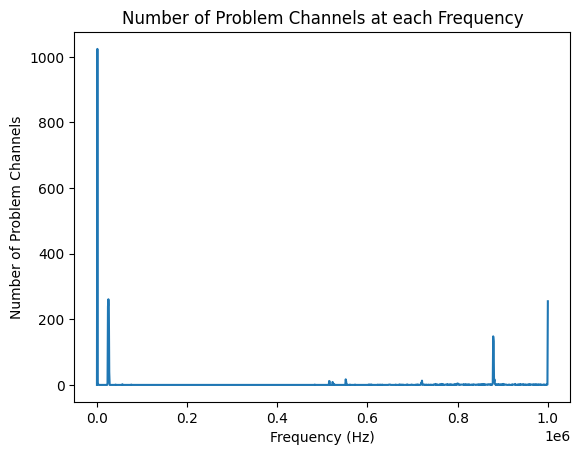

939.8496240601503


In [38]:
## Make a list of the problem frequencies and sort by number of problem channels where the entries are (frequency, number of problem channels)
ProblemFrequenciesCount = []
for i in range(len(ProblemFrequencies)):
    ProblemFrequenciesCount.append([ProblemFrequencies[i][0],len(ProblemFrequencies[i][1])])

print(ProblemFrequenciesCount)

PlotArrayAgainstFrequencies=np.zeros(Analyzer.PSDlength)
for i in range(len(ProblemFrequenciesCount)):
    PlotArrayAgainstFrequencies[ProblemFrequenciesCount[i][0]+1] = ProblemFrequenciesCount[i][1]

plt.figure()
## Add one to the index because we had trimmed off the 0 index before.
#plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing)[np.array(ProblemFrequenciesCount)[:,0]+1],np.array(ProblemFrequenciesCount)[:,1])

plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),PlotArrayAgainstFrequencies)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Number of Problem Channels')
plt.title('Number of Problem Channels at each Frequency')
plt.savefig('ProblemChannelsVsFrequency.png')
plt.show()

print(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing)[np.array(ProblemFrequenciesCount)[:,0][0]+1])



In [39]:
## Sort ProblemFrequenciesCount by number of problem channels
ProblemFrequenciesCountSorted = sorted(ProblemFrequenciesCount,key=lambda x: x[1],reverse=True)
print(ProblemFrequenciesCountSorted)

[[0, 1024], [26, 261], [1063, 255], [27, 243], [25, 239], [934, 148], [935, 133], [28, 39], [586, 17], [937, 17], [766, 13], [547, 12], [548, 11], [587, 11], [936, 10], [555, 9], [1, 7], [24, 6], [556, 6], [764, 6], [765, 6], [933, 6], [849, 4], [851, 4], [938, 4], [798, 3], [812, 3], [958, 3], [986, 3], [59, 2], [559, 2], [808, 2], [815, 2], [826, 2], [833, 2], [843, 2], [846, 2], [850, 2], [853, 2], [865, 2], [870, 2], [877, 2], [887, 2], [900, 2], [904, 2], [907, 2], [911, 2], [913, 2], [914, 2], [923, 2], [924, 2], [928, 2], [940, 2], [945, 2], [947, 2], [951, 2], [956, 2], [979, 2], [993, 2], [997, 2], [999, 2], [1003, 2], [1004, 2], [1018, 2], [1019, 2], [1022, 2], [1029, 2], [1030, 2], [1034, 2], [1041, 2], [1046, 2], [2, 1], [43, 1], [80, 1], [513, 1], [557, 1], [589, 1], [596, 1], [608, 1], [640, 1], [642, 1], [645, 1], [647, 1], [662, 1], [667, 1], [672, 1], [688, 1], [689, 1], [690, 1], [691, 1], [704, 1], [712, 1], [714, 1], [717, 1], [721, 1], [730, 1], [732, 1], [741, 1],

In [40]:
#Problem Frequencies which affect more than 100 channels:
ProblemFrequenciesCountSorted100 = [x for x in ProblemFrequenciesCountSorted if x[1] > 100]
print(ProblemFrequenciesCountSorted100)

[[0, 1024], [26, 261], [1063, 255], [27, 243], [25, 239], [934, 148], [935, 133]]


In [41]:
#Recreate the above list, but replacing the frequency with the frequency in Hz
ProblemFrequenciesCountSorted100Hz = []
for i in range(len(ProblemFrequenciesCountSorted100)):
    ProblemFrequenciesCountSorted100Hz.append([np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing)[ProblemFrequenciesCountSorted100[i][0]+1],ProblemFrequenciesCountSorted100[i][1]])
print(ProblemFrequenciesCountSorted100Hz)

[[939.8496240601503, 1024], [25375.939849624057, 261], [999999.9999999999, 255], [26315.789473684206, 243], [24436.09022556391, 239], [878759.3984962405, 148], [879699.2481203007, 133]]


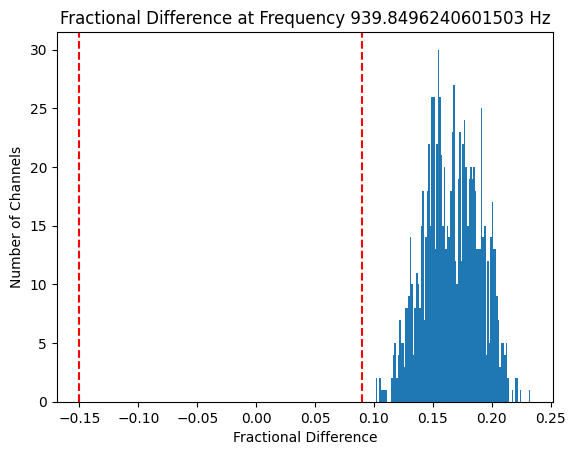

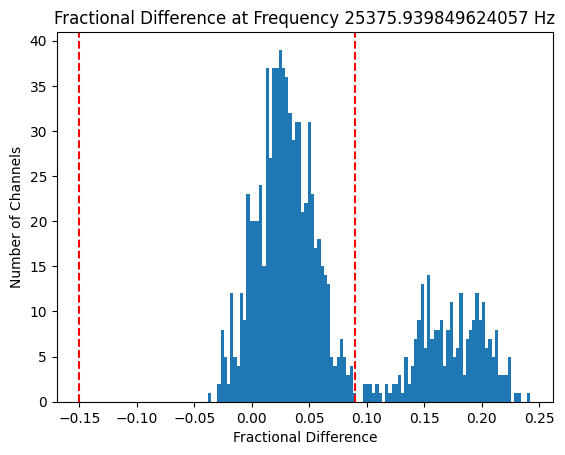

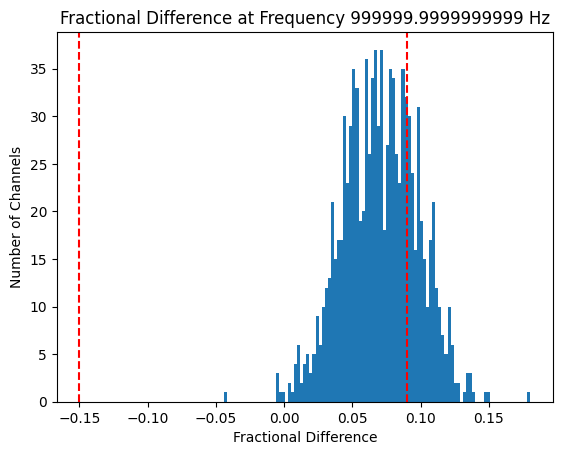

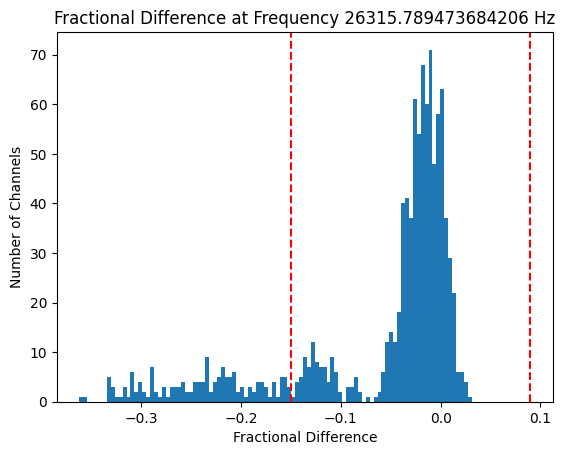

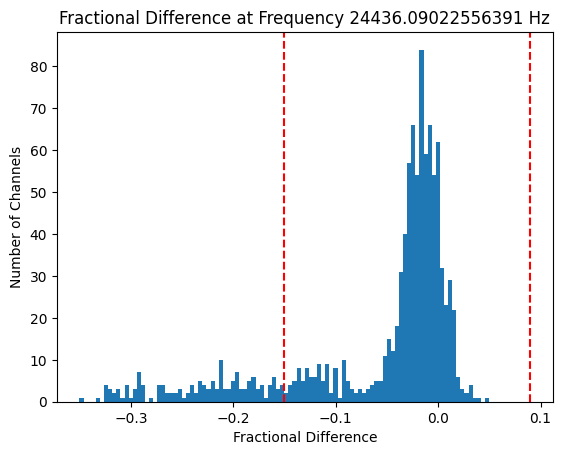

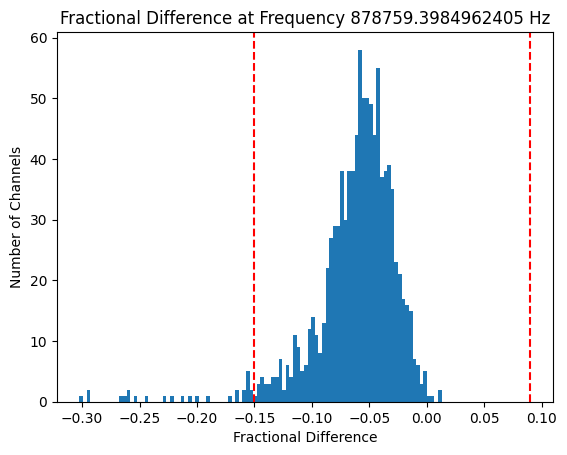

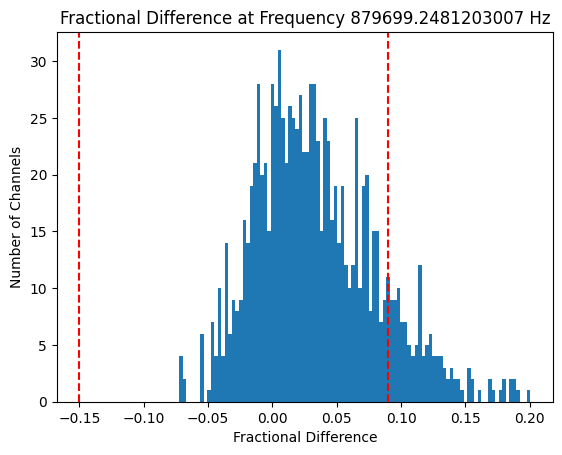

In [11]:
#For each frequency on this list, create a histogram of the fractional difference for all channels at that frequency
for i in range(len(ProblemFrequenciesCountSorted100)):
    plt.figure()
    plt.hist(FractionalDifference[:,ProblemFrequenciesCountSorted100[i][0]],bins=100)
    plt.xlabel('Fractional Difference')
    plt.ylabel('Number of Channels')
    plt.title('Fractional Difference at Frequency '+str(ProblemFrequenciesCountSorted100Hz[i][0])+' Hz')
    ## vertical lines at 0.09 and -0.15
    plt.axvline(x=0.09, color='r', linestyle='--')
    plt.axvline(x=-0.15, color='r', linestyle='--')
    plt.savefig('FractionalDifferenceHist'+str(int(ProblemFrequenciesCountSorted100Hz[i][0]))+'.png')
    plt.show()

In [17]:
## Now, similarly, we will create a list of the problem channels and sort by number of problem frequencies
ProblemChannelsCount = []
for i in range(len(ProblemChannels)):
    ProblemChannelsCount.append([ProblemChannels[i][0],len(ProblemChannels[i][1])])
print(ProblemChannelsCount)

[[0, 2], [1, 1], [2, 1], [3, 2], [4, 1], [5, 2], [6, 1], [7, 3], [8, 1], [9, 1], [10, 1], [11, 1], [12, 3], [13, 1], [14, 2], [15, 1], [16, 1], [17, 1], [18, 1], [19, 1], [20, 1], [21, 2], [22, 1], [23, 1], [24, 1], [25, 2], [26, 2], [27, 1], [28, 1], [29, 2], [30, 1], [31, 2], [32, 2], [33, 1], [34, 1], [35, 1], [36, 1], [37, 1], [38, 3], [39, 1], [40, 24], [41, 3], [42, 1], [43, 4], [44, 2], [45, 1], [46, 1], [47, 2], [48, 1], [49, 1], [50, 2], [51, 2], [52, 1], [53, 1], [54, 2], [55, 2], [56, 2], [57, 2], [58, 2], [59, 1], [60, 1], [61, 2], [62, 4], [63, 4], [64, 2], [65, 3], [66, 4], [67, 3], [68, 3], [69, 3], [70, 2], [71, 1], [72, 1], [73, 1], [74, 1], [75, 1], [76, 2], [77, 1], [78, 1], [79, 3], [80, 7], [81, 6], [82, 5], [83, 4], [84, 6], [85, 4], [86, 4], [87, 4], [88, 5], [89, 5], [90, 6], [91, 6], [92, 7], [93, 6], [94, 7], [95, 6], [96, 5], [97, 5], [98, 4], [99, 7], [100, 4], [101, 4], [102, 4], [103, 5], [104, 4], [105, 4], [106, 4], [107, 5], [108, 4], [109, 4], [110, 4]

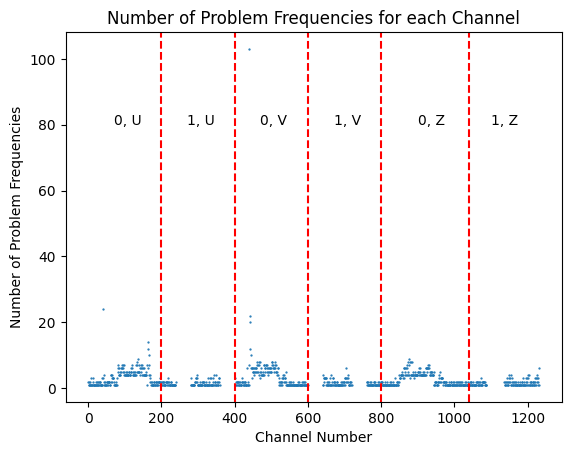

In [32]:
## Plot the number of problem frequencies for each channel
plt.figure()
plt.scatter(np.array(ProblemChannelsCount)[:,0],np.array(ProblemChannelsCount)[:,1],marker='.',s=1.5)
plt.xlabel('Channel Number')
plt.ylabel('Number of Problem Frequencies')
plt.title('Number of Problem Frequencies for each Channel')

##Draw vertical lines to separate each plane
plt.axvline(x=200, color='r', linestyle='--')
plt.axvline(x=400, color='r', linestyle='--')
plt.axvline(x=600, color='r', linestyle='--')
plt.axvline(x=800, color='r', linestyle='--')
plt.axvline(x=1040, color='r', linestyle='--')

#Label in text in each region on the plot which TPC and plane it belongs to
plt.text(70, 80, '0, U')
plt.text(270, 80, '1, U')
plt.text(470, 80, '0, V')
plt.text(670, 80, '1, V')
plt.text(900, 80, '0, Z')
plt.text(1100, 80, '1, Z')

plt.savefig('ProblemFrequenciesVsChannel.png')

plt.show()

In [18]:
## Sort ProblemChannelsCount by number of problem frequencies
ProblemChannelsCountSorted = sorted(ProblemChannelsCount,key=lambda x: x[1],reverse=True)
print(ProblemChannelsCountSorted)

#Problem Channels which have more than 20 problem frequencies
ProblemChannelsCountSorted20 = [x for x in ProblemChannelsCountSorted if x[1] >= 20]
print(ProblemChannelsCountSorted20)

#Recreate the above list, but replacing the channel number with the TPC and plane
print(plotter.convert_index_to_sorted(ProblemChannelsCountSorted20[0][0]))
print(plotter.convert_index_to_sorted(ProblemChannelsCountSorted20[1][0]))
print(plotter.convert_index_to_sorted(ProblemChannelsCountSorted20[2][0]))
print(plotter.convert_index_to_sorted(ProblemChannelsCountSorted20[3][0]))




[[440, 103], [40, 24], [442, 22], [443, 20], [163, 14], [164, 12], [441, 12], [165, 10], [444, 10], [136, 9], [877, 9], [132, 8], [461, 8], [467, 8], [469, 8], [502, 8], [503, 8], [509, 8], [873, 8], [879, 8], [881, 8], [883, 8], [80, 7], [92, 7], [94, 7], [99, 7], [119, 7], [130, 7], [134, 7], [138, 7], [144, 7], [146, 7], [161, 7], [166, 7], [439, 7], [462, 7], [463, 7], [465, 7], [480, 7], [481, 7], [485, 7], [486, 7], [489, 7], [501, 7], [504, 7], [510, 7], [514, 7], [871, 7], [875, 7], [929, 7], [931, 7], [81, 6], [84, 6], [90, 6], [91, 6], [93, 6], [95, 6], [116, 6], [120, 6], [142, 6], [143, 6], [148, 6], [149, 6], [153, 6], [162, 6], [434, 6], [445, 6], [446, 6], [447, 6], [451, 6], [454, 6], [455, 6], [457, 6], [459, 6], [471, 6], [482, 6], [483, 6], [488, 6], [490, 6], [494, 6], [495, 6], [496, 6], [500, 6], [505, 6], [507, 6], [508, 6], [511, 6], [517, 6], [519, 6], [703, 6], [861, 6], [863, 6], [865, 6], [867, 6], [869, 6], [902, 6], [906, 6], [922, 6], [923, 6], [925, 6], 

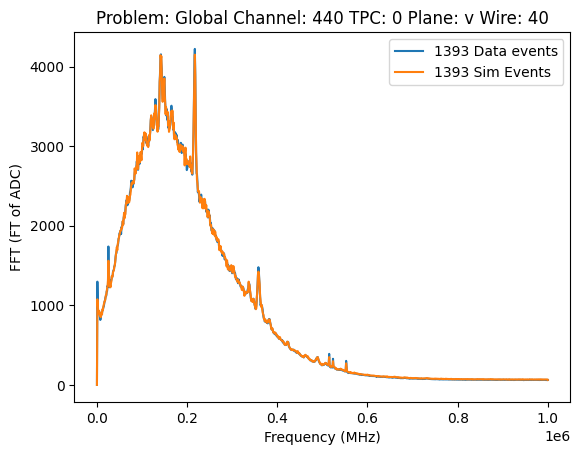

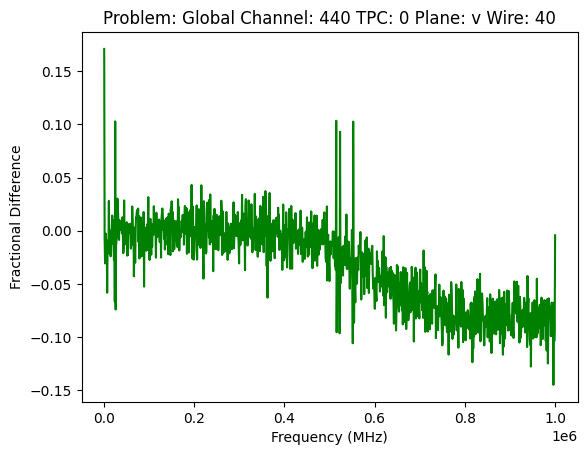

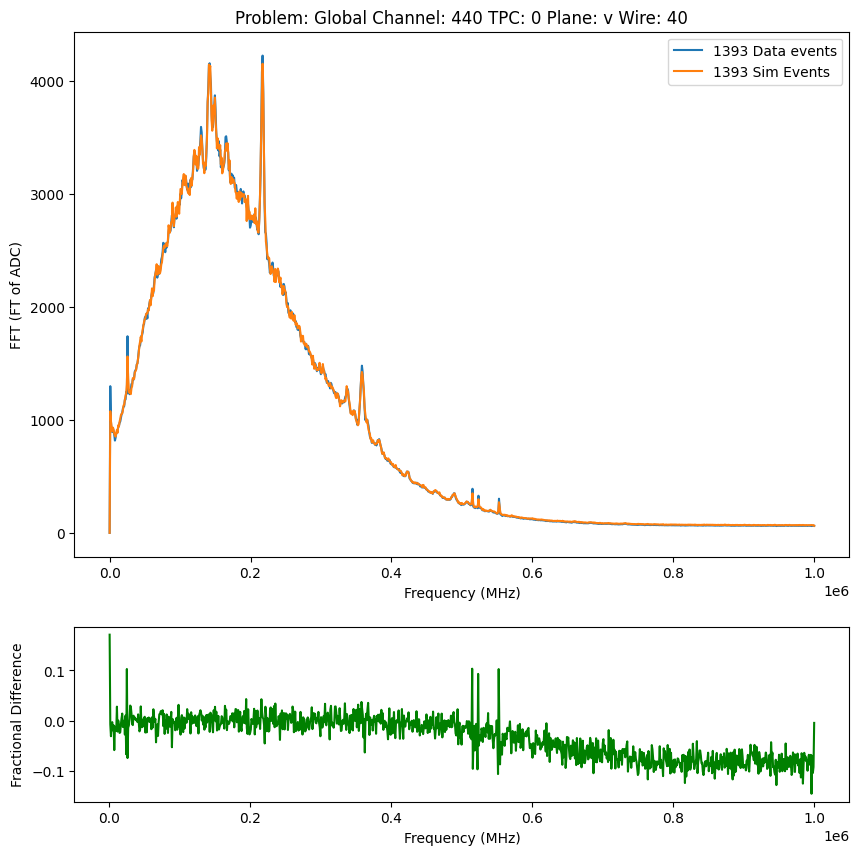

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


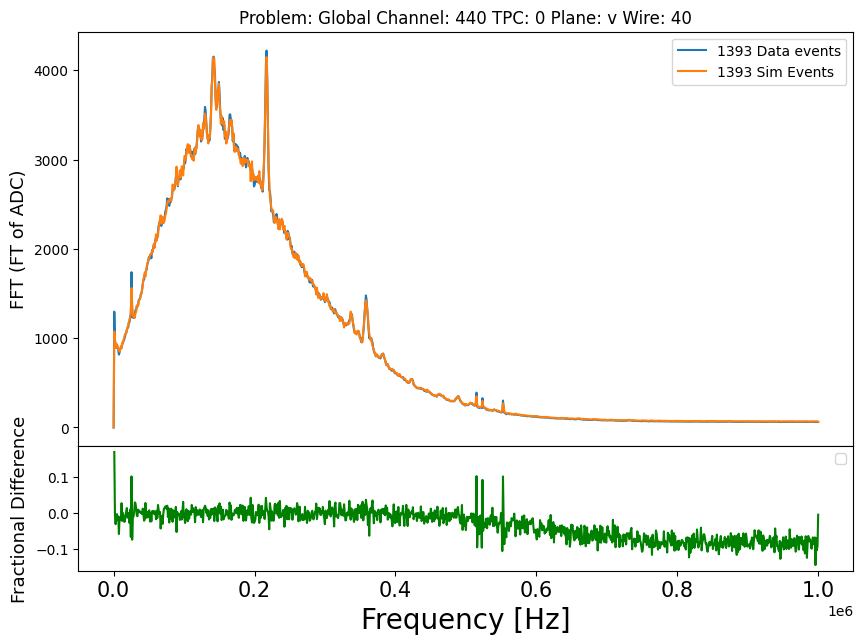

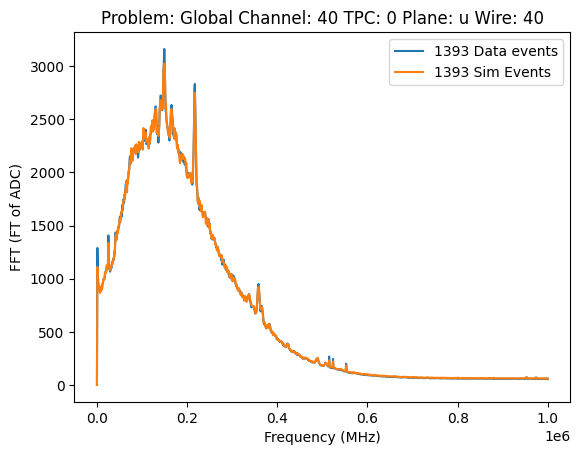

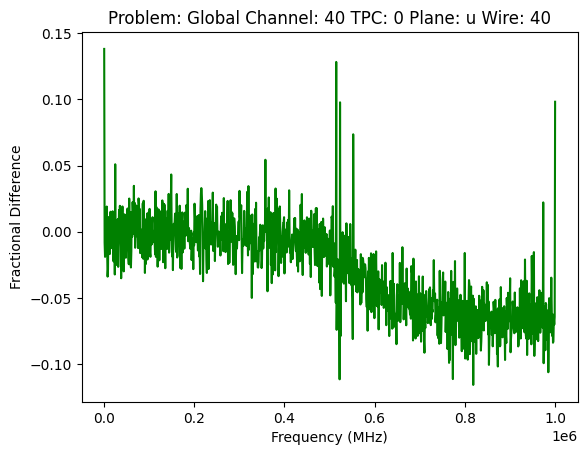

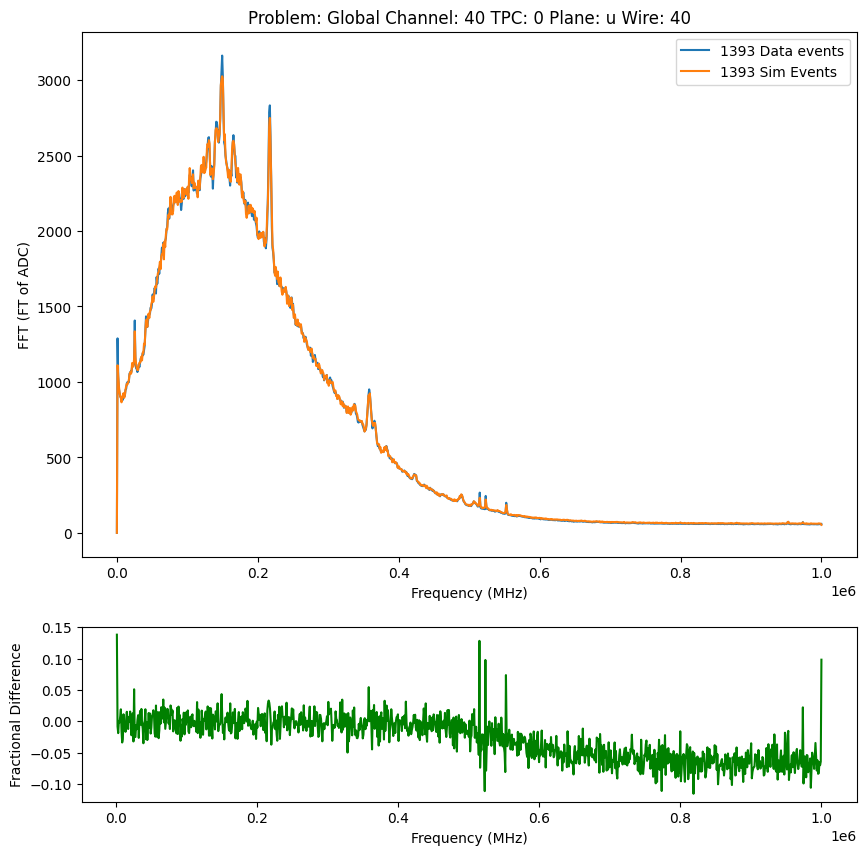

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


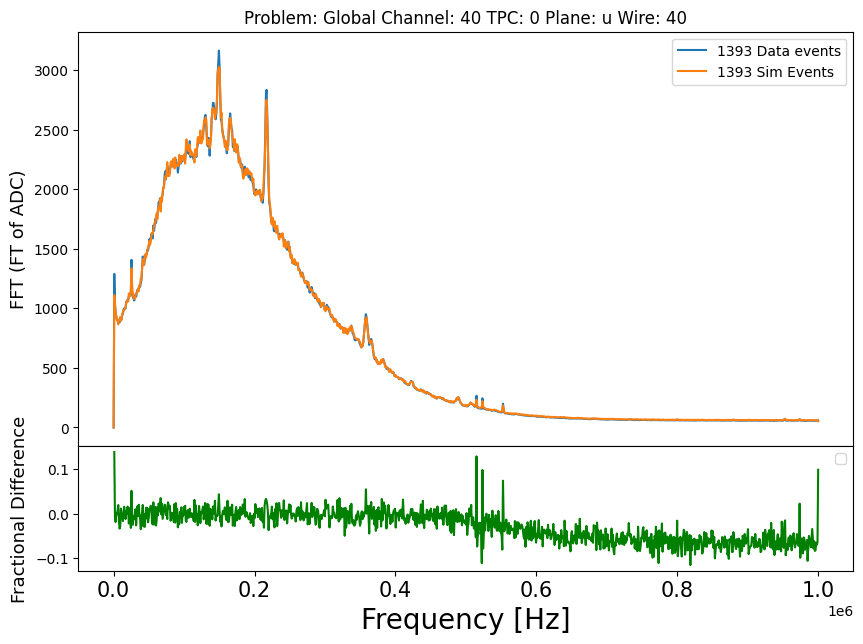

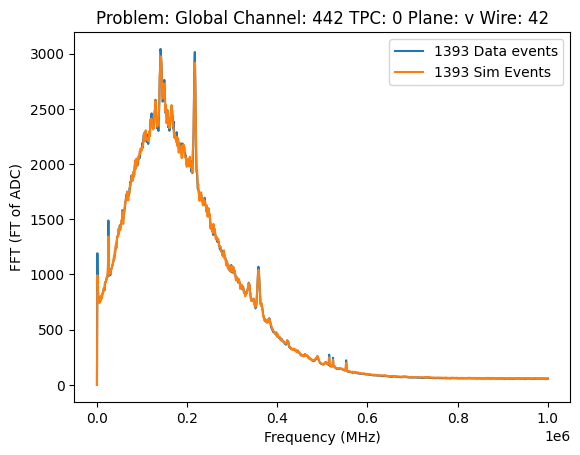

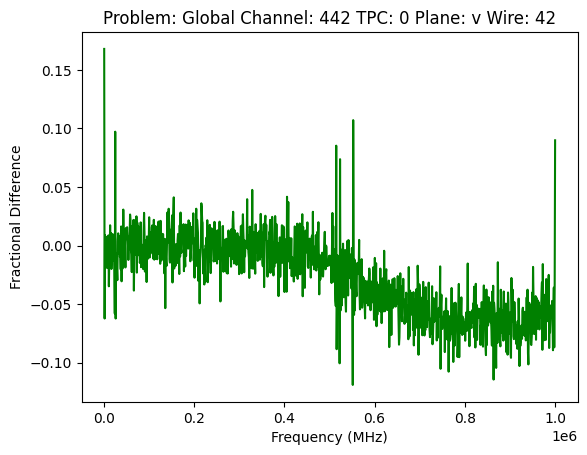

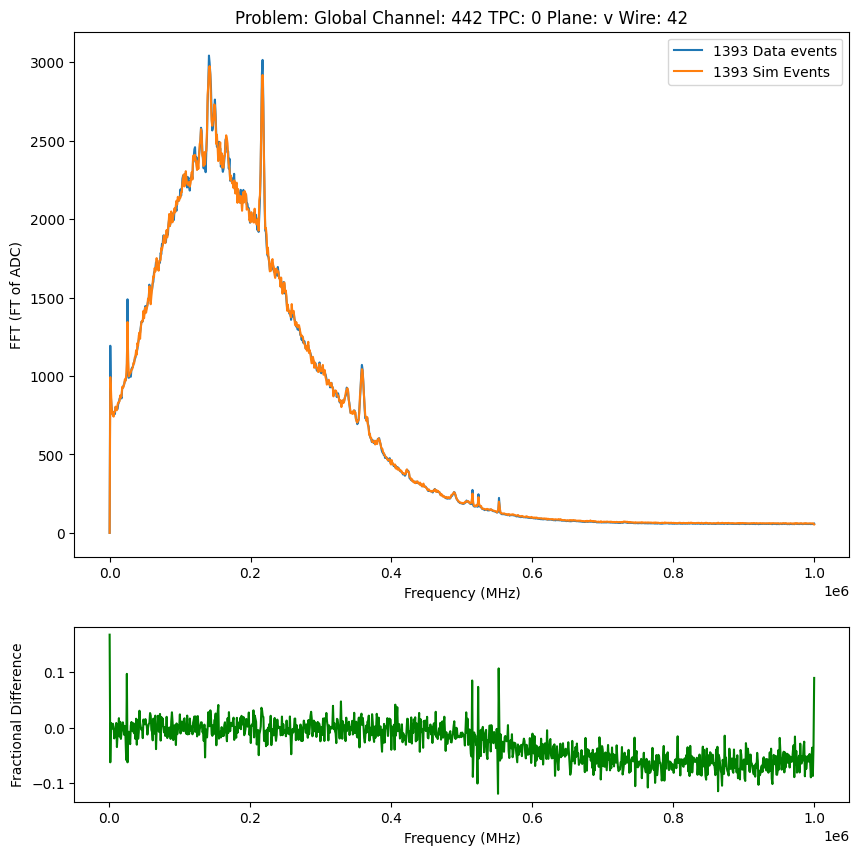

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


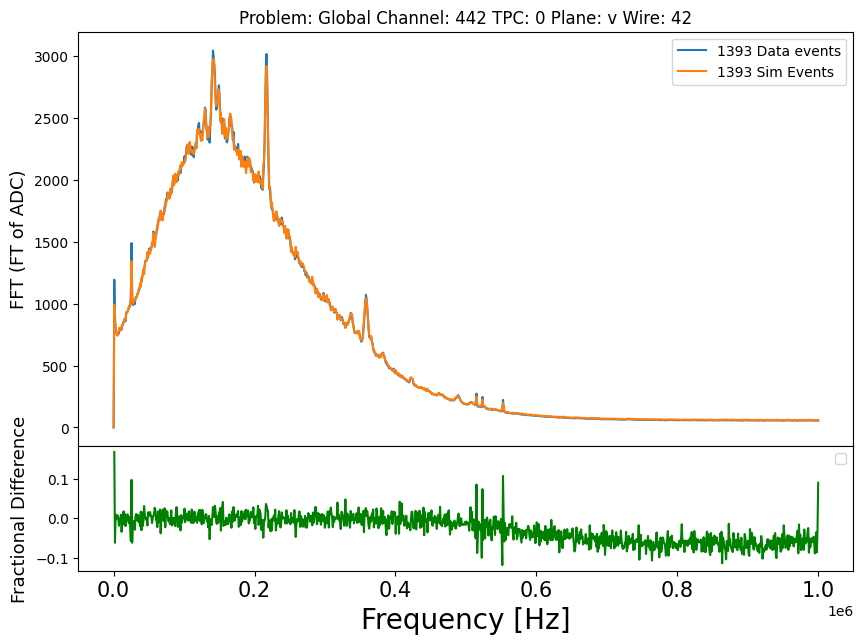

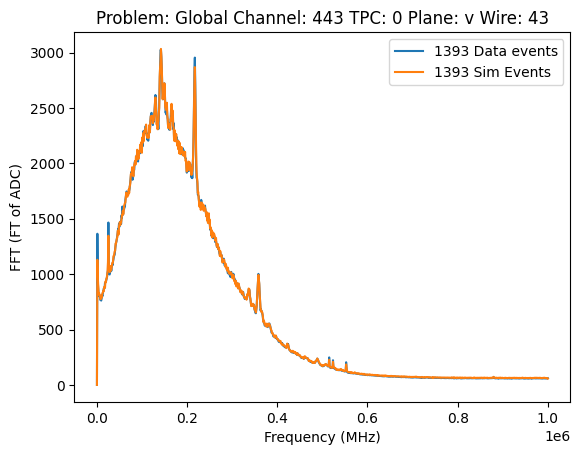

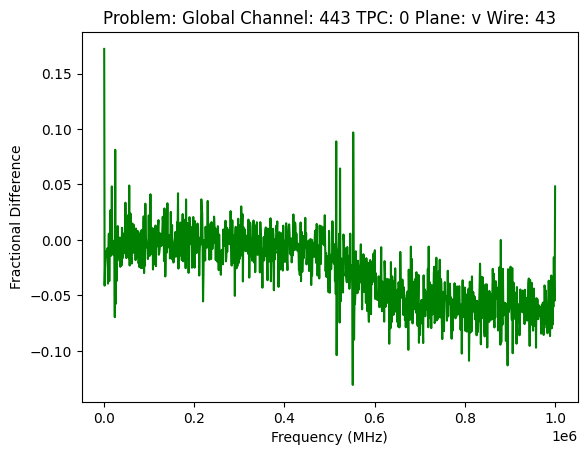

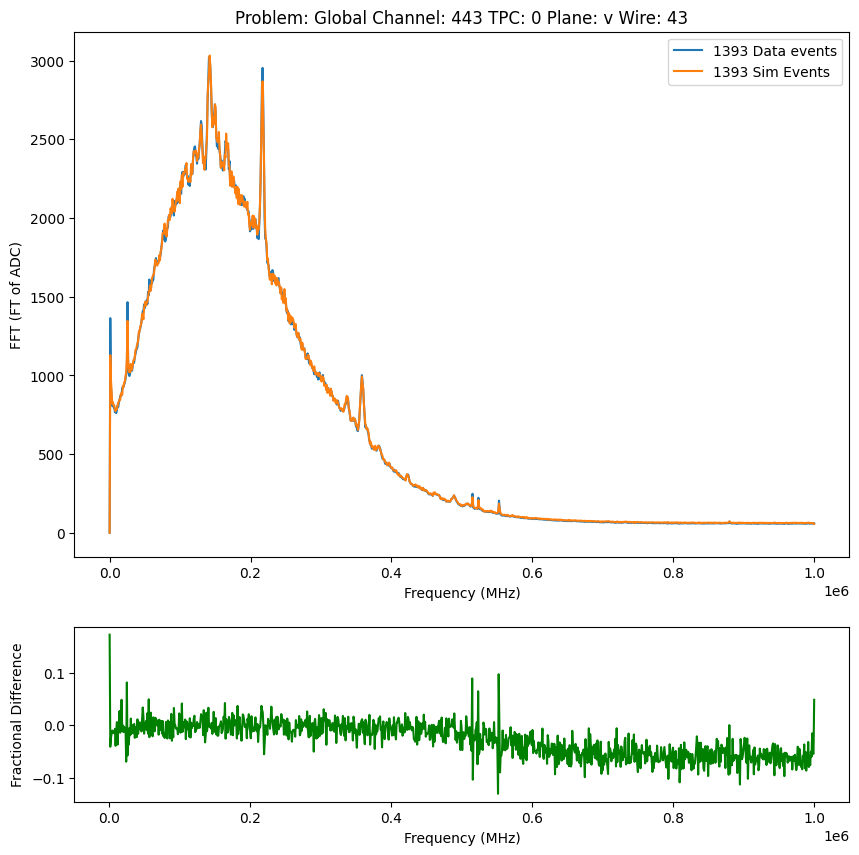

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


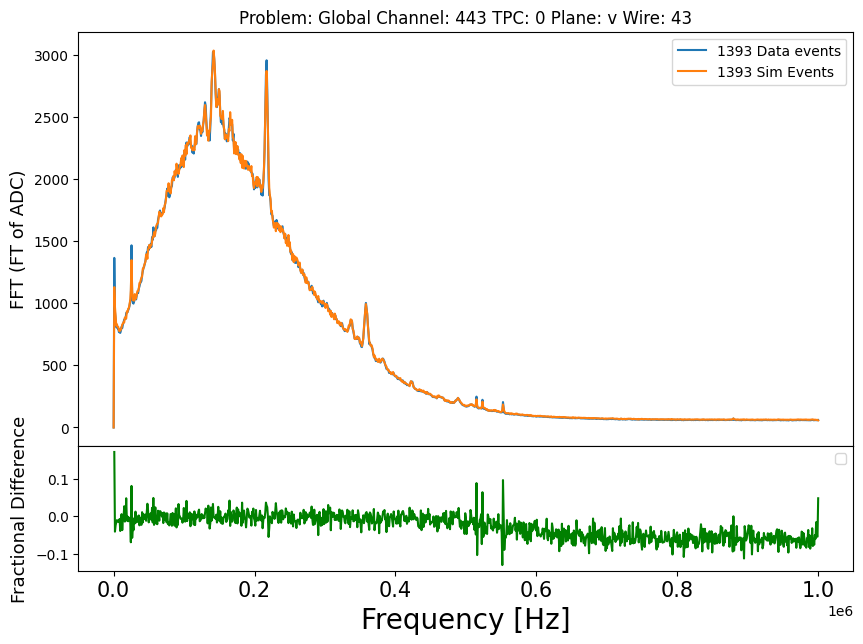

In [42]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

ProblemChannelsLocations = np.zeros((len(ProblemChannelsCountSorted20),3),dtype=int)
for i in range(len(ProblemChannelsCountSorted20)):
    ProblemChannelsLocations[i] = plotter.convert_index_to_sorted(ProblemChannelsCountSorted20[i][0])

planenames = ["u", "v", "z"]

for i in range(len(ProblemChannelsCountSorted20)):
    fig = plt.figure()
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),FFT[ProblemChannelsCountSorted20[i][0]],label = "1393 Data events")
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),AverageFFT[ProblemChannelsCountSorted20[i][0]],label = "1393 Sim Events")
    plt.title('Problem: Global Channel: '+str(ProblemChannelsCountSorted20[i][0]) + ' TPC: ' + str(ProblemChannelsLocations[i][0]) + ' Plane: ' + planenames[ProblemChannelsLocations[i][1]] + ' Wire: ' + str(ProblemChannelsLocations[i][2]))
    plt.xlabel('Frequency (MHz)')
    plt.ylabel('FFT (FT of ADC)')
    plt.legend()
    fig.savefig(str(ProblemChannelsCountSorted20[i][0])+'.png', dpi = fig.dpi)
    plt.show()

    ## Show the fractional difference for each of these channels as well
    fig = plt.figure()
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing)[1:],FractionalDifference[ProblemChannelsCountSorted20[i][0]],color='green')
    plt.title('Problem: Global Channel: '+str(ProblemChannelsCountSorted20[i][0]) + ' TPC: ' + str(ProblemChannelsLocations[i][0]) + ' Plane: ' + planenames[ProblemChannelsLocations[i][1]] + ' Wire: ' + str(ProblemChannelsLocations[i][2]))
    plt.xlabel('Frequency (MHz)')
    plt.ylabel('Fractional Difference')
    fig.savefig(str(ProblemChannelsCountSorted20[i][0])+'FractionalDifference.png', dpi = fig.dpi)

    #Now make a plot that is horizontally divided into two parts, the top part is the FFT and the bottom part is the fractional difference
    #No gap between the top and bottom parts, and make the top part 3 times the size of the bottom part

    fig, axs = plt.subplots(2, figsize=(10, 10), gridspec_kw={'height_ratios': [3, 1]})
    axs[0].plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),FFT[ProblemChannelsCountSorted20[i][0]],label = "1393 Data events")
    axs[0].plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),AverageFFT[ProblemChannelsCountSorted20[i][0]],label = "1393 Sim Events")
    axs[0].set_title('Problem: Global Channel: '+str(ProblemChannelsCountSorted20[i][0]) + ' TPC: ' + str(ProblemChannelsLocations[i][0]) + ' Plane: ' + planenames[ProblemChannelsLocations[i][1]] + ' Wire: ' + str(ProblemChannelsLocations[i][2]))
    axs[0].set_xlabel('Frequency (MHz)')
    axs[0].set_ylabel('FFT (FT of ADC)')
    axs[0].legend()
    axs[1].plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing)[1:],FractionalDifference[ProblemChannelsCountSorted20[i][0]],color='green')
    axs[1].set_xlabel('Frequency (MHz)')
    axs[1].set_ylabel('Fractional Difference')
    #fig.savefig(str(ProblemChannelsCountSorted20[i][0])+'FractionalDifference.png', dpi = fig.dpi)
    plt.show()

    #Declare the fixed size of the total plot (main plot + residual plot)
    fig, axPlot = plt.subplots(figsize=(10,7))

    #Create the residual plot as being appended to the bottom of the main plot, 40% the vertical size of the main plot
    divider = make_axes_locatable(axPlot)
    axRes = divider.append_axes("bottom", size="30%", pad=0)
    axPlot.figure.add_axes(axRes)

    #Plot the main plot
    axPlot.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),FFT[ProblemChannelsCountSorted20[i][0]],label = "1393 Data events")
    axPlot.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),AverageFFT[ProblemChannelsCountSorted20[i][0]],label = "1393 Sim Events")
    
    axRes.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing)[1:],FractionalDifference[ProblemChannelsCountSorted20[i][0]],color='green')

    #axPlot.get_shared_x_axes().join(axPlot, axRes)
    axPlot.sharex(axRes)

    axPlot.set_title('Problem: Global Channel: '+str(ProblemChannelsCountSorted20[i][0]) + ' TPC: ' + str(ProblemChannelsLocations[i][0]) + ' Plane: ' + planenames[ProblemChannelsLocations[i][1]] + ' Wire: ' + str(ProblemChannelsLocations[i][2]))

    axPlot.set_ylabel("FFT (FT of ADC)", size = 13)
    axRes.set_ylabel("Fractional Difference", size = 13)
    plt.xlabel("Frequency [Hz]", size = 20)
    plt.xticks(fontsize = 15)
    #plt.setp(axPlot.get_yticklabels(), Fontsize=15)
    #plt.setp(axRes.get_yticklabels(), Fontsize=15)
    axPlot.legend()
    axRes.legend()
    fig.savefig(str(ProblemChannelsCountSorted20[i][0])+'Combined.png', dpi = fig.dpi)




No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


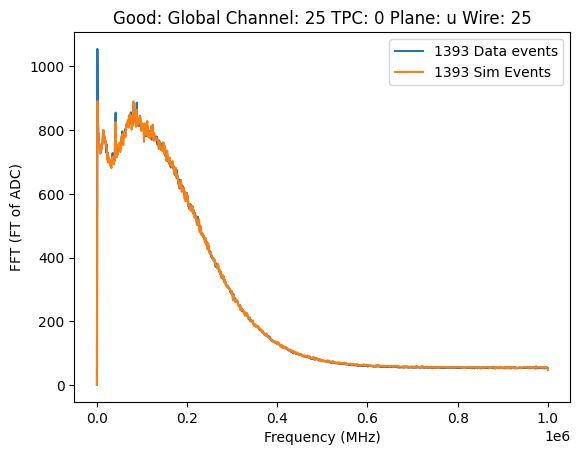

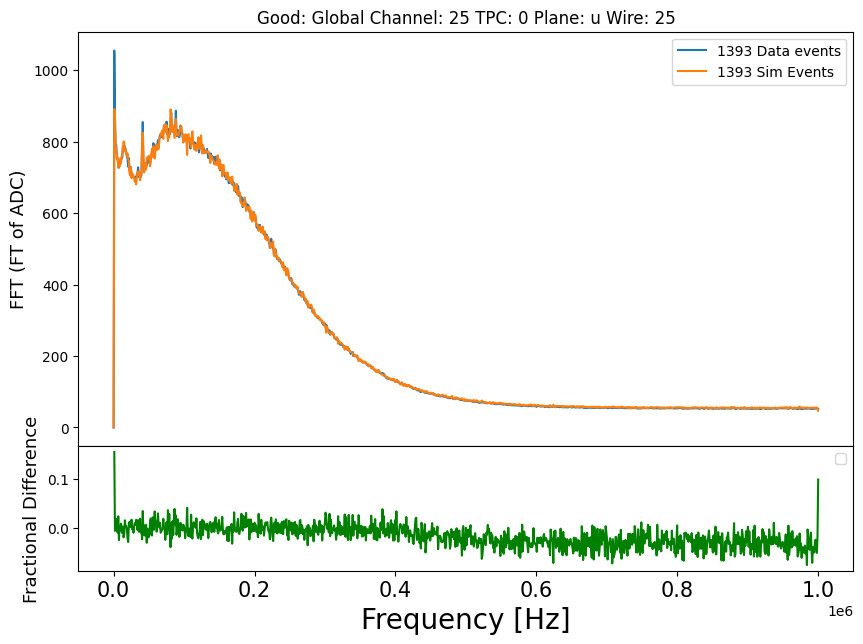

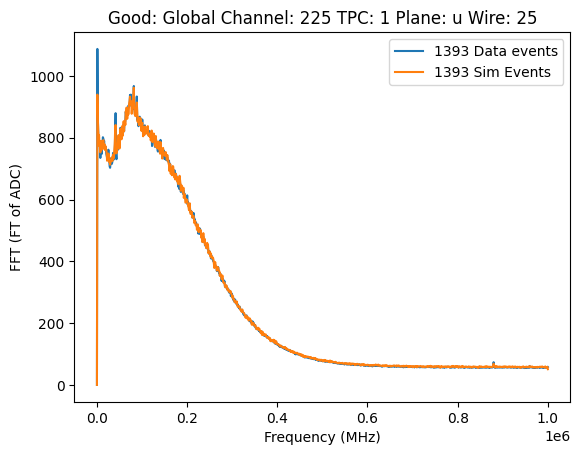

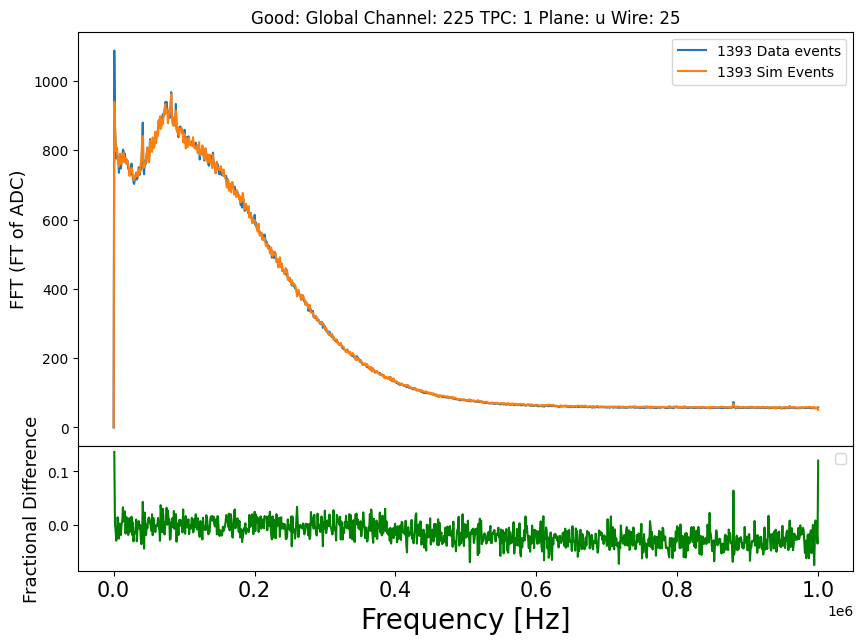

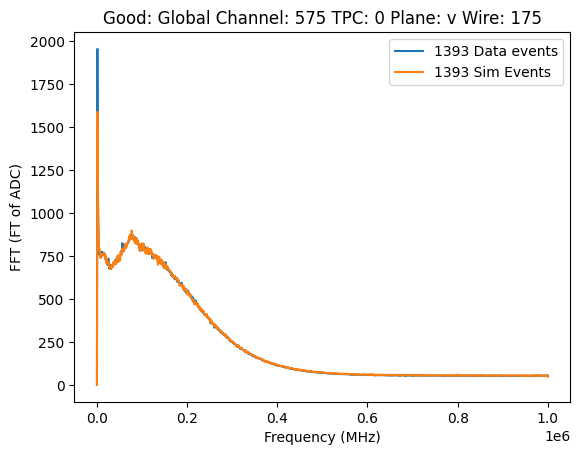

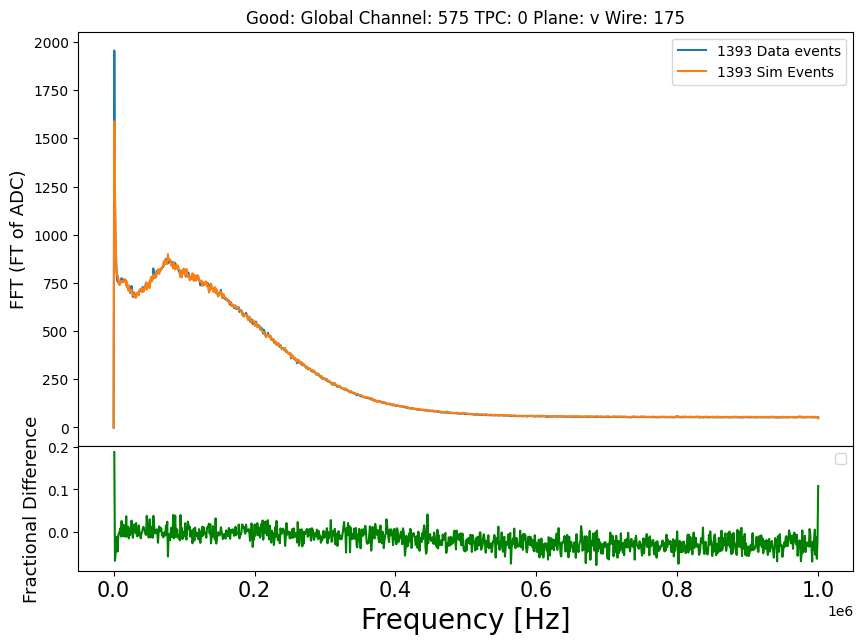

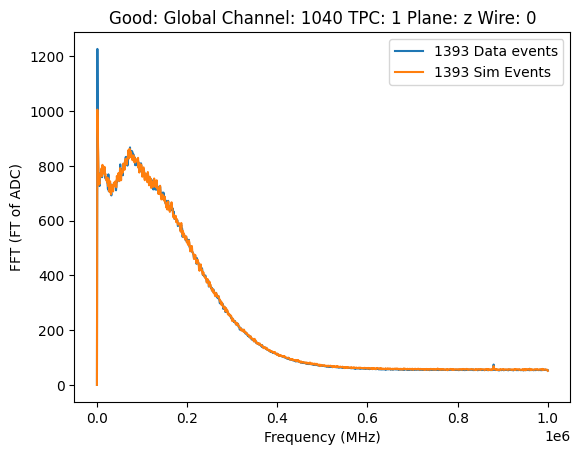

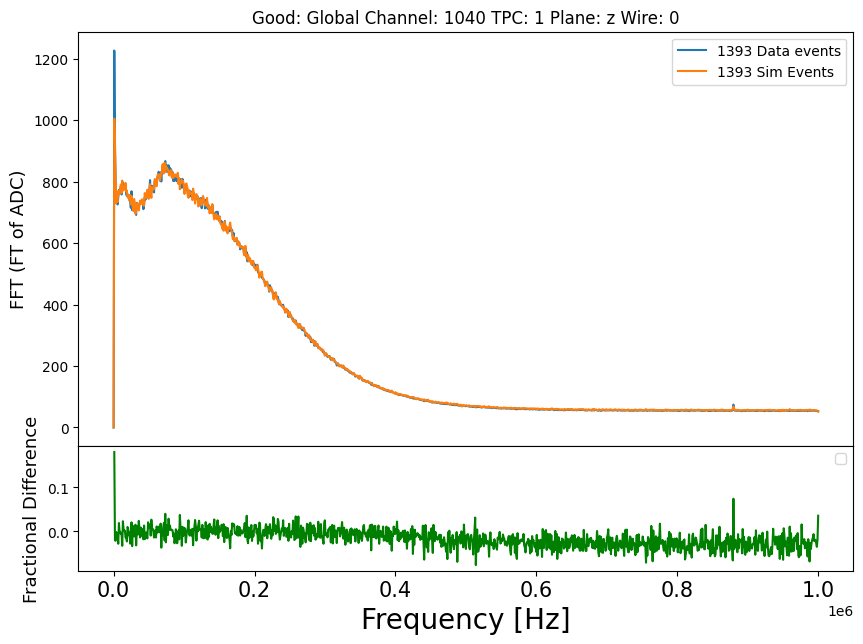

In [44]:
##A few FFT overlays of some good channels
GoodChannels = [25,225,575,1040]
GoodChannelsLocations = np.zeros((len(GoodChannels),3),dtype=int)

for i in range(len(GoodChannels)):
    GoodChannelsLocations[i] = plotter.convert_index_to_sorted(GoodChannels[i])

planenames = ["u", "v", "z"]

for i in range(len(GoodChannels)):
    fig = plt.figure()
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),FFT[GoodChannels[i]],label = "1393 Data events")
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),AverageFFT[GoodChannels[i]],label = "1393 Sim Events")
    plt.title('Good: Global Channel: '+str(GoodChannels[i]) + ' TPC: ' + str(GoodChannelsLocations[i][0]) + ' Plane: ' + planenames[GoodChannelsLocations[i][1]] + ' Wire: ' + str(GoodChannelsLocations[i][2]))
    plt.xlabel('Frequency (MHz)')
    plt.ylabel('FFT (FT of ADC)')
    plt.legend()
    fig.savefig(str(GoodChannels[i])+'.png', dpi = fig.dpi)

    ## Show the fractional difference for each of these channels as well
    #fig = plt.figure()

    ##Make the same fractional difference combined plot as before for the problem channels, now for the good channels
    #Declare the fixed size of the total plot (main plot + residual plot)
    fig, axPlot = plt.subplots(figsize=(10,7))

    #Create the residual plot as being appended to the bottom of the main plot, 40% the vertical size of the main plot
    divider = make_axes_locatable(axPlot)
    axRes = divider.append_axes("bottom", size="30%", pad=0)
    axPlot.figure.add_axes(axRes)

    #Plot the main plot
    axPlot.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),FFT[GoodChannels[i]],label = "1393 Data events")
    axPlot.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),AverageFFT[GoodChannels[i]],label = "1393 Sim Events")
    
    axRes.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing)[1:],FractionalDifference[GoodChannels[i]],color='green')

    #axPlot.get_shared_x_axes().join(axPlot, axRes)
    axPlot.sharex(axRes)

    axPlot.set_title('Good: Global Channel: '+str(GoodChannels[i]) + ' TPC: ' + str(GoodChannelsLocations[i][0]) + ' Plane: ' + planenames[GoodChannelsLocations[i][1]] + ' Wire: ' + str(GoodChannelsLocations[i][2]))

    axPlot.set_ylabel("FFT (FT of ADC)", size = 13)
    axRes.set_ylabel("Fractional Difference", size = 13)
    plt.xlabel("Frequency [Hz]", size = 20)
    plt.xticks(fontsize = 15)
    #plt.setp(axPlot.get_yticklabels(), Fontsize=15)
    #plt.setp(axRes.get_yticklabels(), Fontsize=15)
    axPlot.legend()
    axRes.legend()
    fig.savefig(str(GoodChannels[i])+'Combined.png', dpi = fig.dpi)
    
    


[24436.09022556]
[26315.78947368]
[24436.09022556]
[26315.78947368]
[817669.17293233]
[931390.97744361]
[24436.09022556]
[24436.09022556]
[26315.78947368]
[24436.09022556]
[26315.78947368]
[24436.09022556]
[26315.78947368]
[24436.09022556 26315.78947368]
[24436.09022556 26315.78947368]
[26315.78947368]
[24436.09022556]
[26315.78947368]
[26315.78947368]
[26315.78947368]
[26315.78947368]


/tmp/ipykernel_769203/3007177394.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


[26315.78947368]
[55451.12781955]
[24436.09022556391, 26315.789473684206, 24436.09022556391, 26315.789473684206, 817669.1729323308, 931390.9774436089, 24436.09022556391, 24436.09022556391, 26315.789473684206, 24436.09022556391, 26315.789473684206, 24436.09022556391, 26315.789473684206, 24436.09022556391, 26315.789473684206, 24436.09022556391, 26315.789473684206, 26315.789473684206, 24436.09022556391, 26315.789473684206, 26315.789473684206, 26315.789473684206, 26315.789473684206, 26315.789473684206, 55451.12781954887]


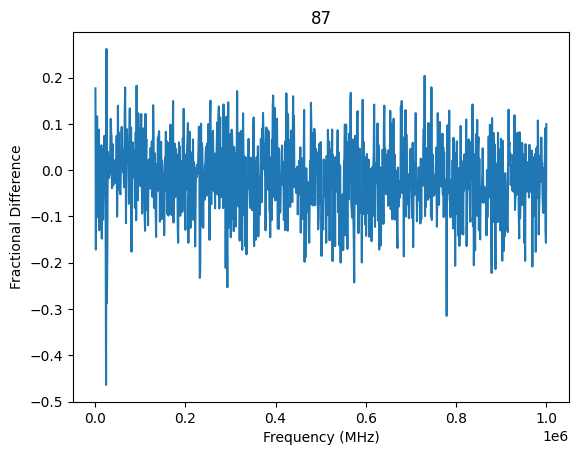

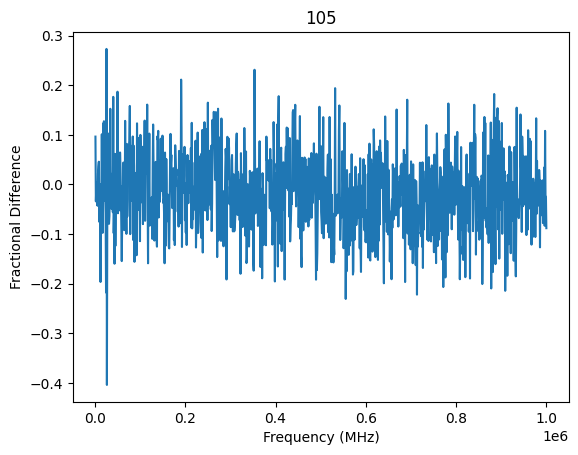

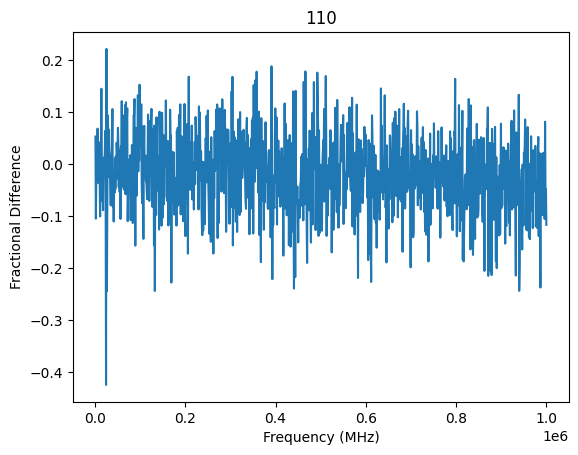

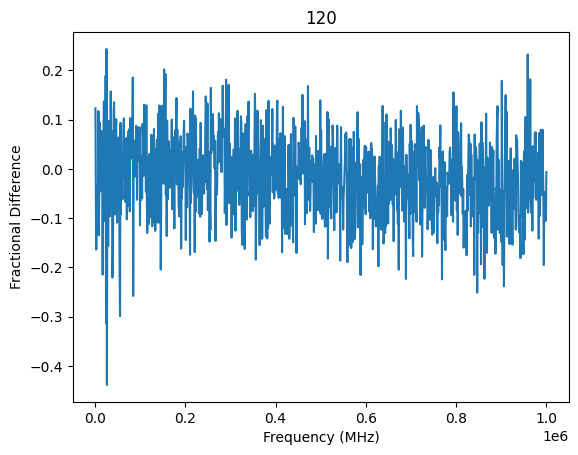

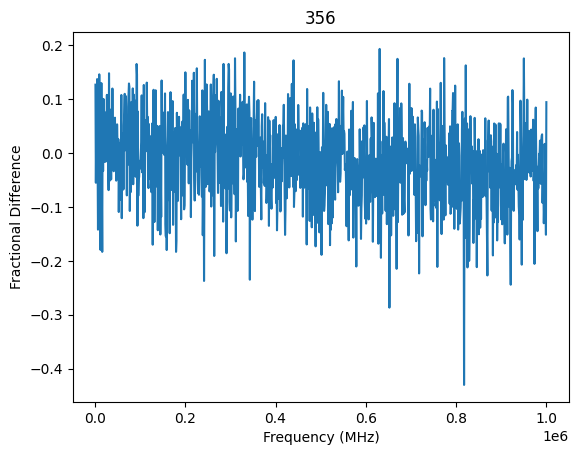

...

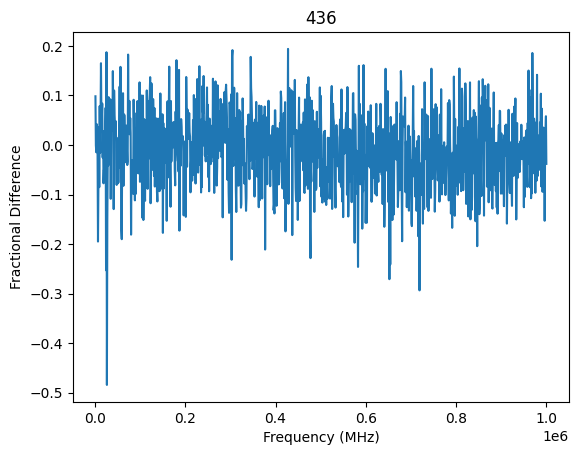

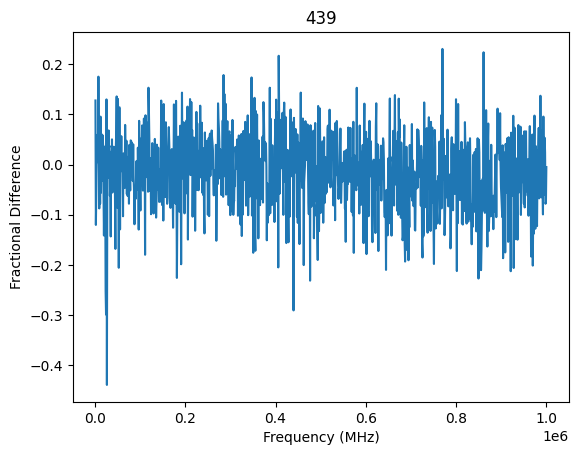

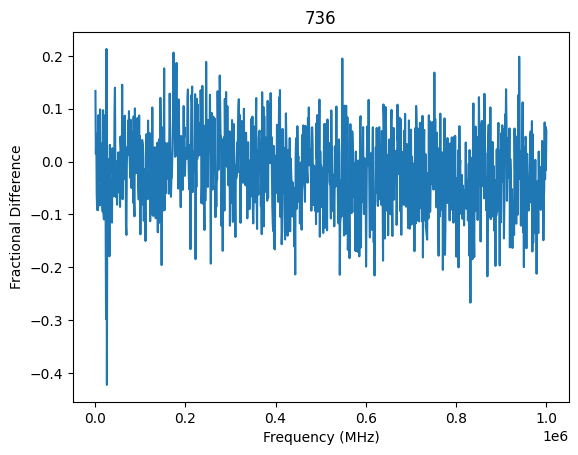

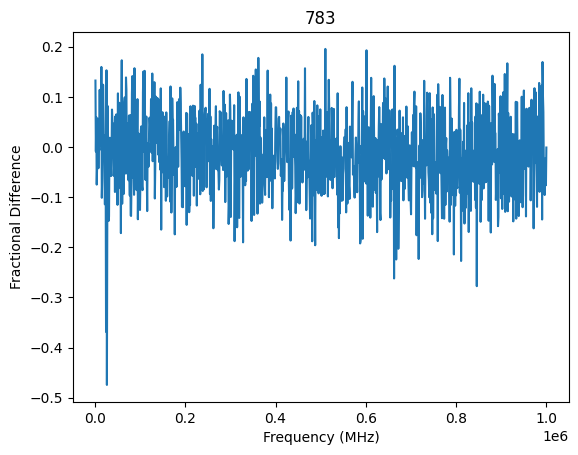

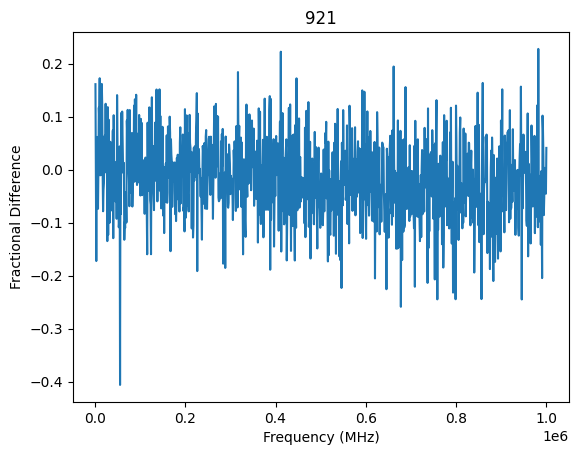

In [16]:
import matplotlib.pyplot as plt
offending_frequencies = []

for i in range(len(np.where(VeryBadChannels==1)[0])):
    plt.figure()
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing)[1:],FractionalDifference[np.where(VeryBadChannels==1)[0][i]])
    plt.title(np.where(VeryBadChannels==1)[0][i])
    plt.xlabel('Frequency (MHz)')
    plt.ylabel('Fractional Difference')
    plt.savefig(str(np.where(VeryBadChannels==1)[0][i])+'.png')
    #print out the frequency of the bin we're consistently underestimating
    this_offending = np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing)[1:][np.where(np.abs(FractionalDifference[np.where(VeryBadChannels==1)[0][i]]) > 0.4)]
    print(this_offending)
    for frequency in this_offending:
        offending_frequencies.append(frequency)


In [17]:
print(offending_frequencies)
#Print out each entry of offending_frequencies with its multiplicity
from collections import Counter
print(Counter(offending_frequencies))


[24436.09022556391, 26315.789473684206, 24436.09022556391, 26315.789473684206, 817669.1729323308, 931390.9774436089, 24436.09022556391, 24436.09022556391, 26315.789473684206, 24436.09022556391, 26315.789473684206, 24436.09022556391, 26315.789473684206, 24436.09022556391, 26315.789473684206, 24436.09022556391, 26315.789473684206, 26315.789473684206, 24436.09022556391, 26315.789473684206, 26315.789473684206, 26315.789473684206, 26315.789473684206, 26315.789473684206, 55451.12781954887]
Counter({26315.789473684206: 13, 24436.09022556391: 9, 817669.1729323308: 1, 931390.9774436089: 1, 55451.12781954887: 1})


/tmp/ipykernel_769203/1309340530.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


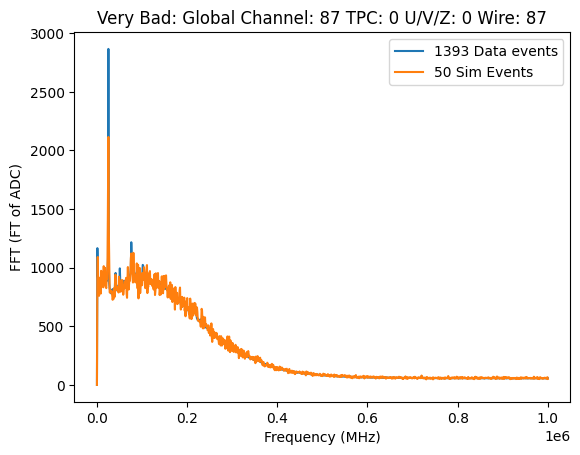

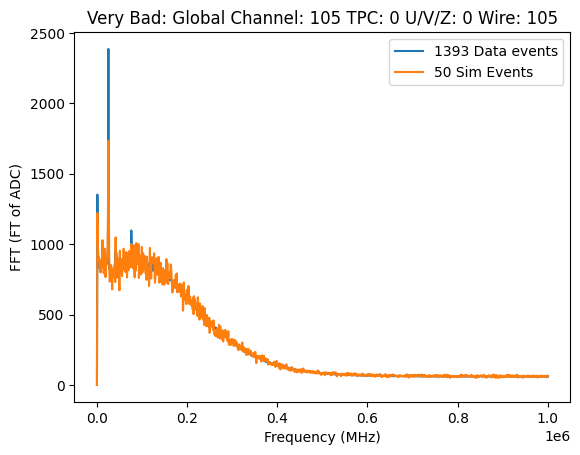

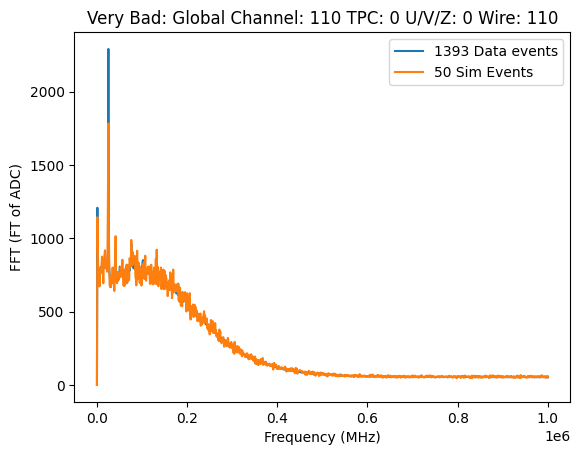

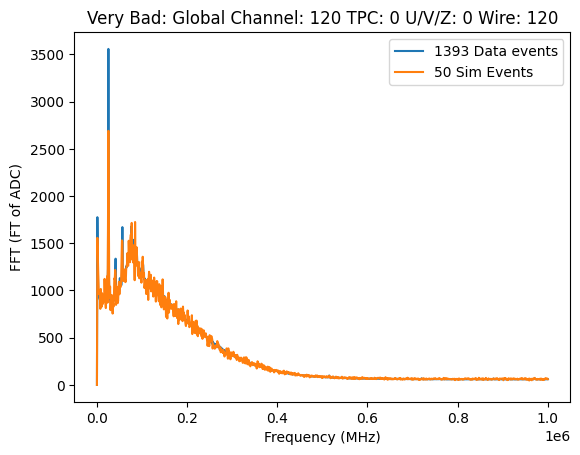

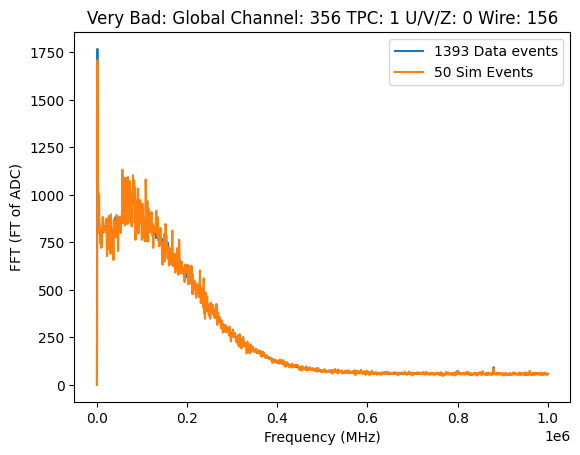

...

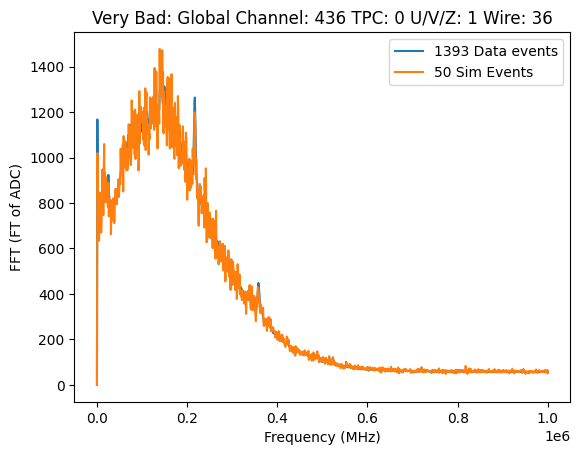

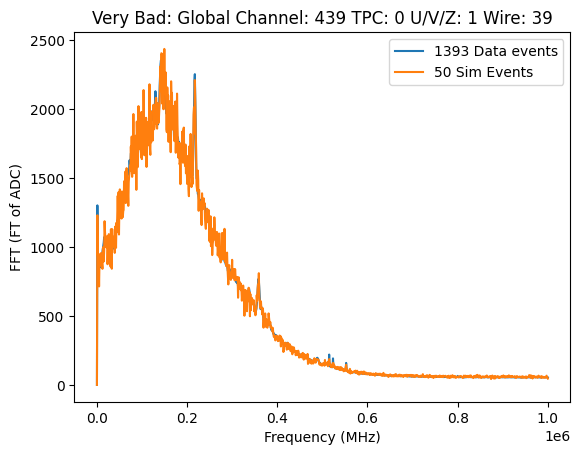

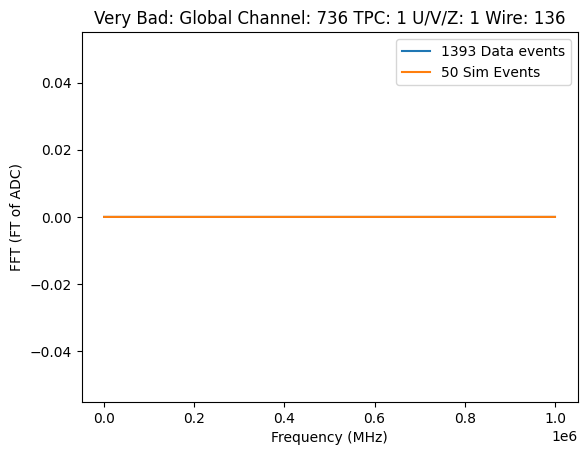

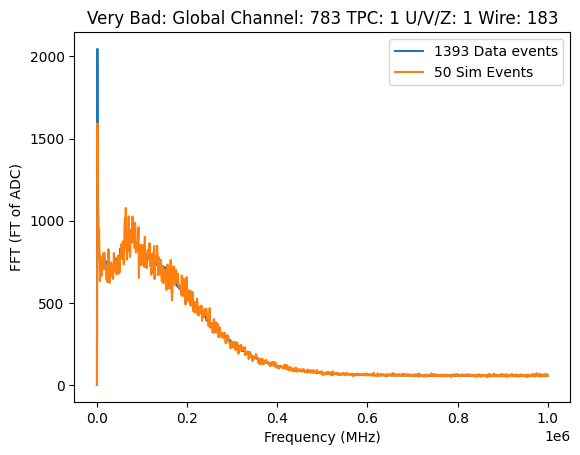

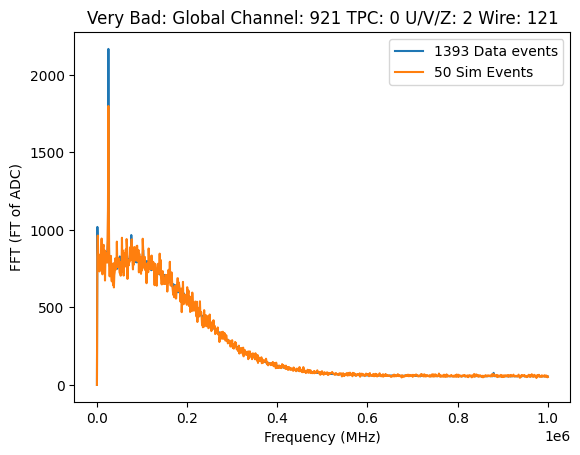

In [12]:
VeryBadChannelsLocations = np.zeros((len(np.where(VeryBadChannels==1)[0]),3),dtype=int)
for i in range(len(np.where(VeryBadChannels==1)[0])):
    VeryBadChannelsLocations[i] = plotter.convert_index_to_sorted(np.where(VeryBadChannels==1)[0][i])

planenames = ["u", "v", "z"]

for i in range(len(np.where(VeryBadChannels==1)[0])):
    fig = plt.figure()
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),FFT[np.where(VeryBadChannels==1)[0][i]],label = "1393 Data events")
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),AverageFFT[np.where(VeryBadChannels==1)[0][i]],label = "50 Sim Events")
    plt.title('Very Bad: Global Channel: '+str(np.where(VeryBadChannels==1)[0][i]) + ' TPC: ' + str(VeryBadChannelsLocations[i][0]) + ' U/V/Z: ' + str(VeryBadChannelsLocations[i][1]) + ' Wire: ' + str(VeryBadChannelsLocations[i][2]))
    plt.xlabel('Frequency (MHz)')
    plt.ylabel('FFT (FT of ADC)')
    plt.legend()
    fig.savefig(str(np.where(VeryBadChannels==1)[0][i])+'.png', dpi = fig.dpi)


/tmp/ipykernel_47202/2871554534.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


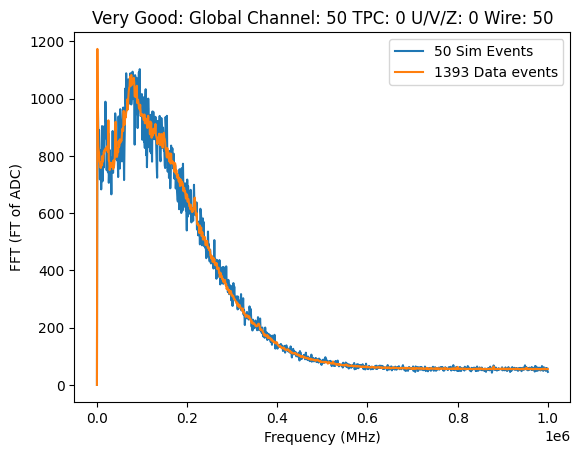

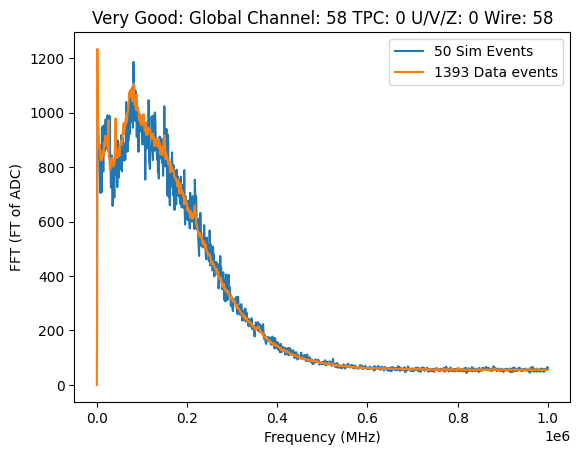

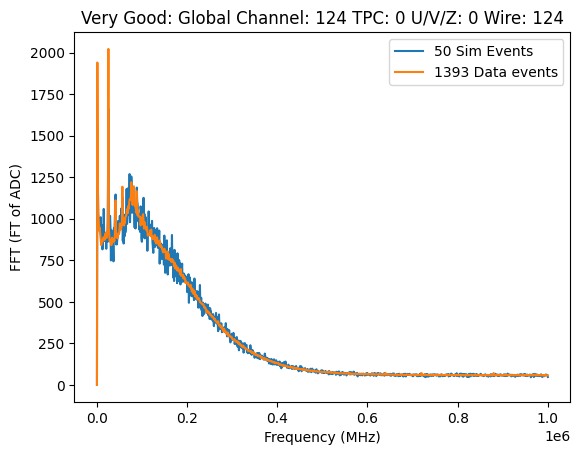

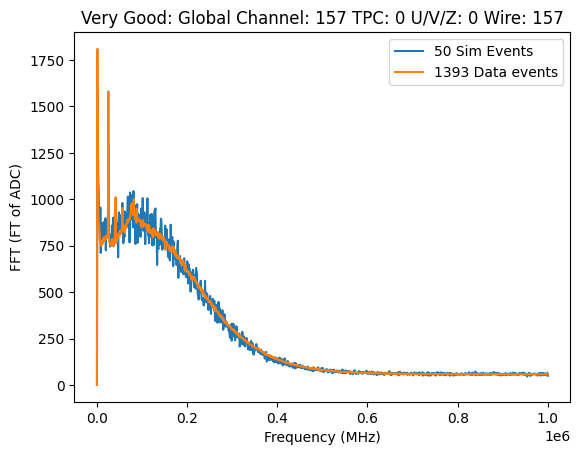

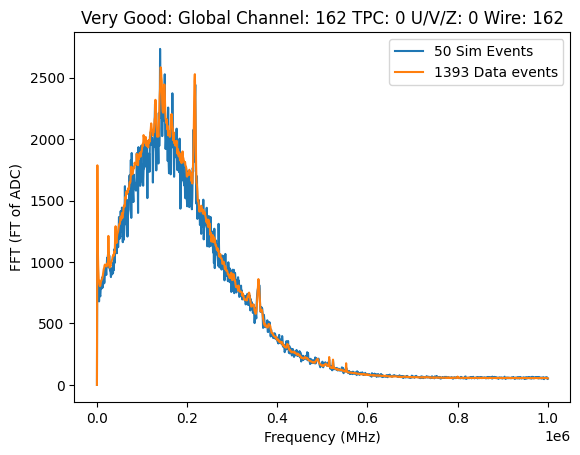

...

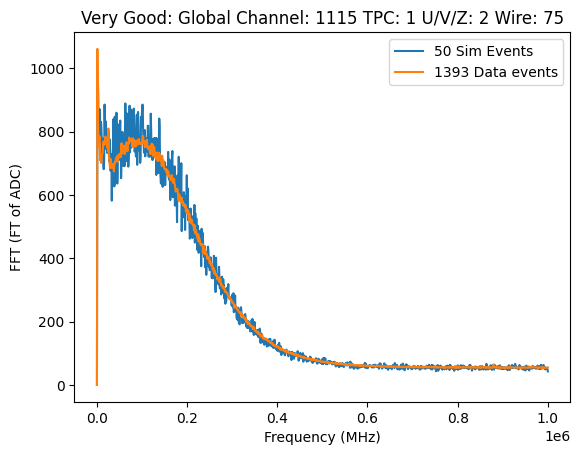

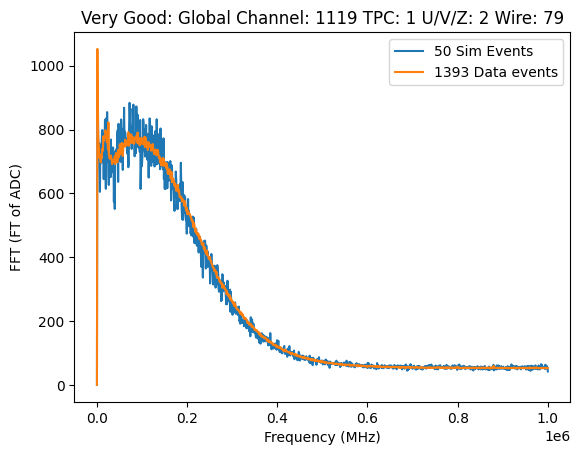

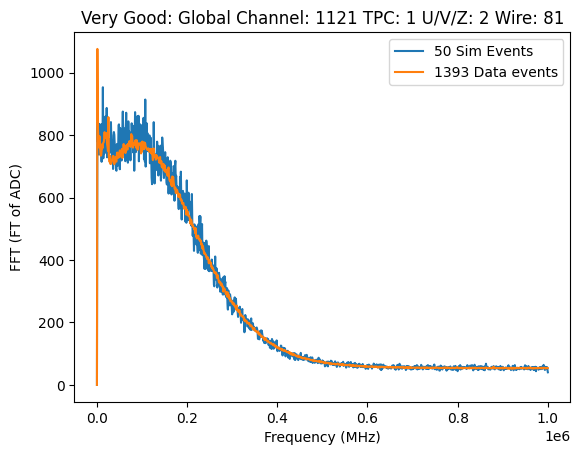

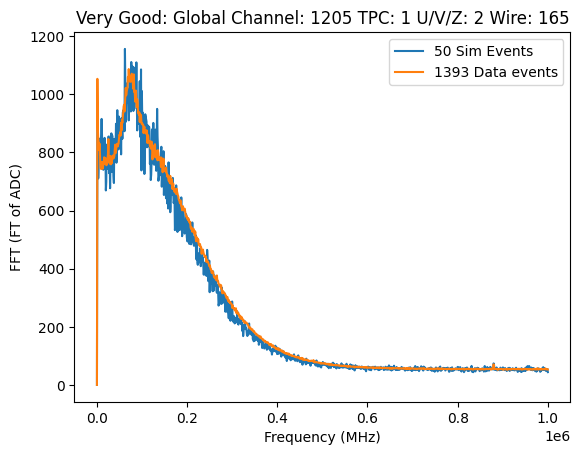

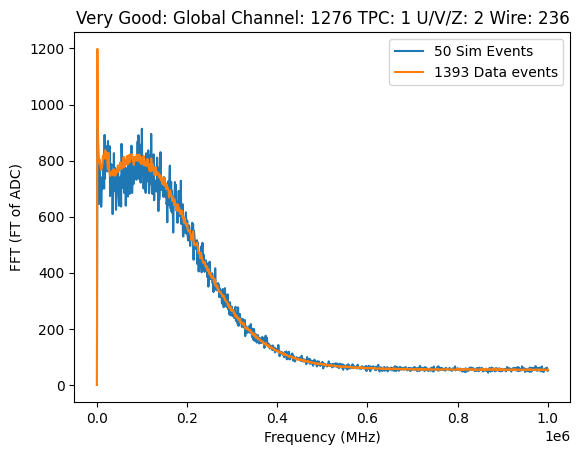

In [42]:
VeryGoodChannelsLocations = np.zeros((len(np.where(VeryGoodChannels==1)[0]),3),dtype=int)
for i in range(len(np.where(VeryGoodChannels==1)[0])):
    VeryGoodChannelsLocations[i] = convert_index_to_sorted(np.where(VeryGoodChannels==1)[0][i])

planenames = ["u", "v", "z"]

for i in range(len(np.where(VeryGoodChannels==1)[0])):
    fig = plt.figure()
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),AverageFFT[np.where(VeryGoodChannels==1)[0][i]],label = "50 Sim Events")
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),FFT[np.where(VeryGoodChannels==1)[0][i]],label = "1393 Data events")
    plt.title('Very Good: Global Channel: '+str(np.where(VeryGoodChannels==1)[0][i]) + ' TPC: ' + str(VeryGoodChannelsLocations[i][0]) + ' U/V/Z: ' + str(VeryGoodChannelsLocations[i][1]) + ' Wire: ' + str(VeryGoodChannelsLocations[i][2]))
    plt.xlabel('Frequency (MHz)')
    plt.ylabel('FFT (FT of ADC)')
    plt.legend()
    fig.savefig(str(np.where(VeryGoodChannels==1)[0][i])+'.png', dpi = fig.dpi)

In [30]:
def convert_index_to_sorted(index):
    if(index < 200):
        return 0,0,index
    elif(index < 400):
         return 1,0,index-200
    elif(index < 600):
        return 0,1,index-400
    elif(index < 800):
        return 1,1,index-600
    elif(index < 1040):
        return 0,2,index-800
    elif(index < 1280):
        return 1,2,index-1040
    else:
        return -1,-1,-1

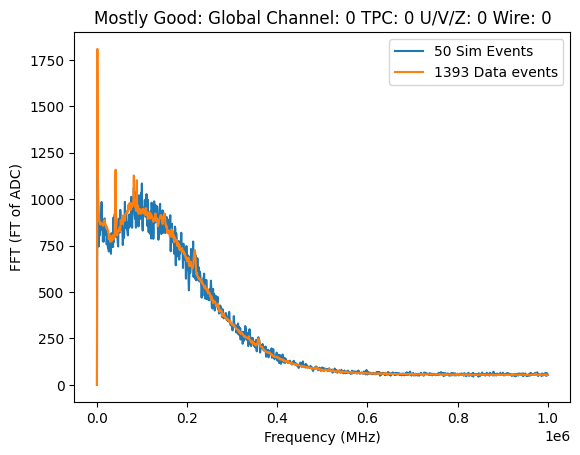

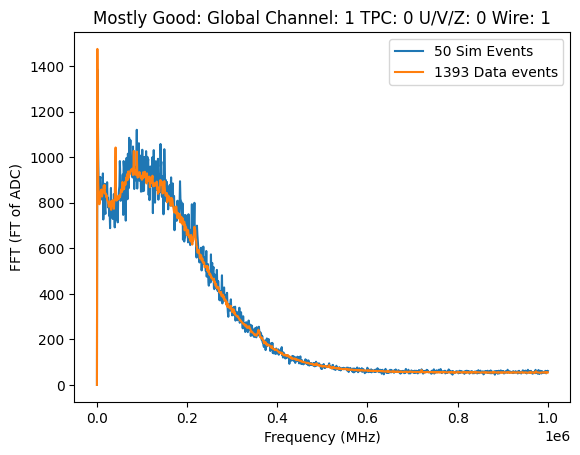

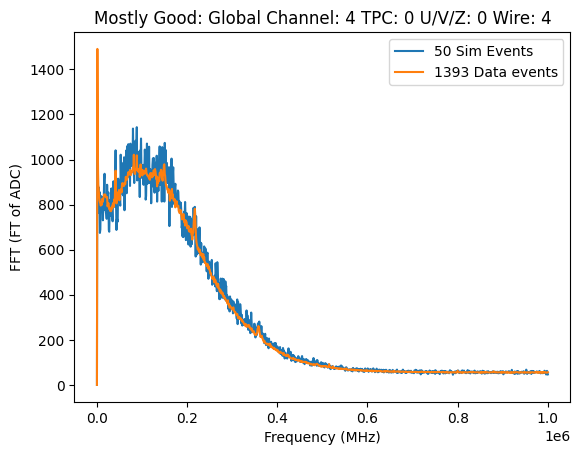

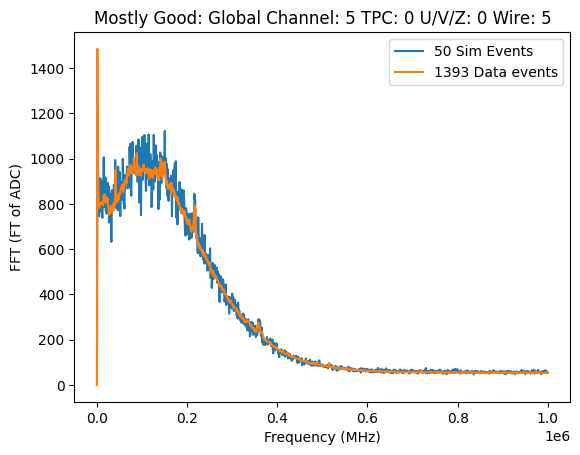

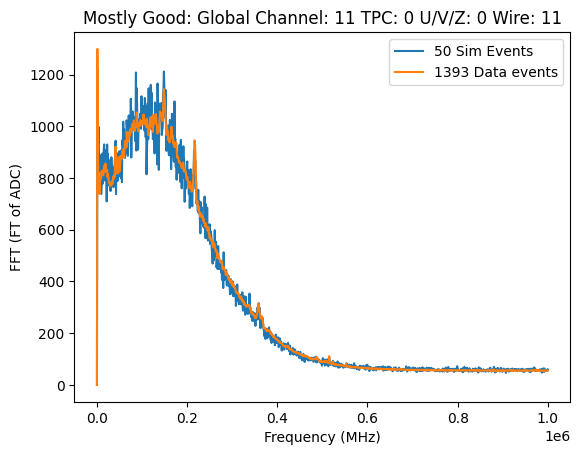

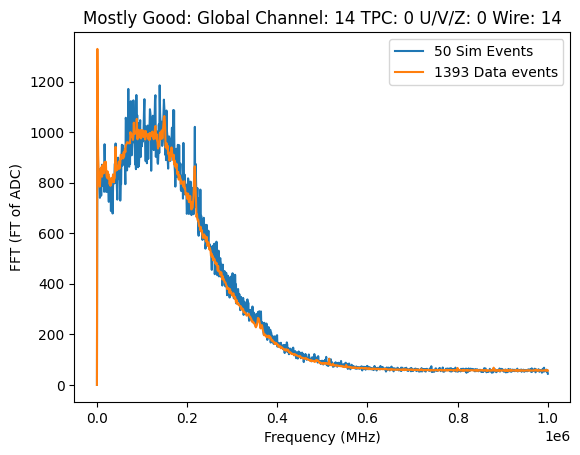

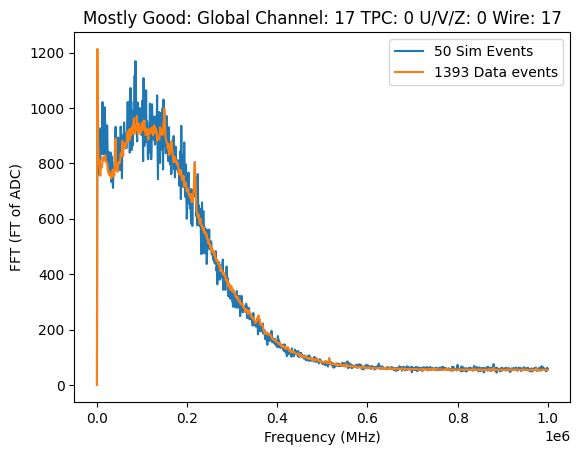

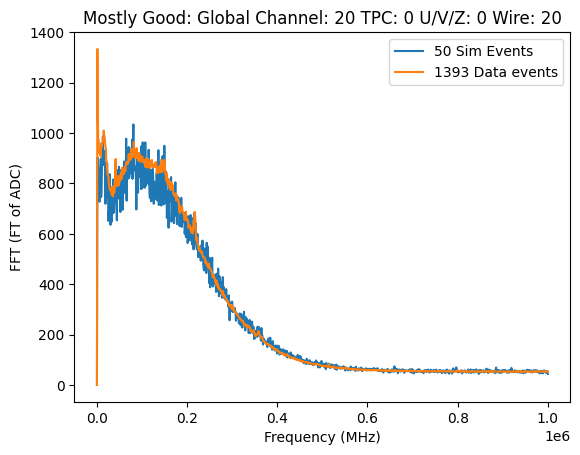

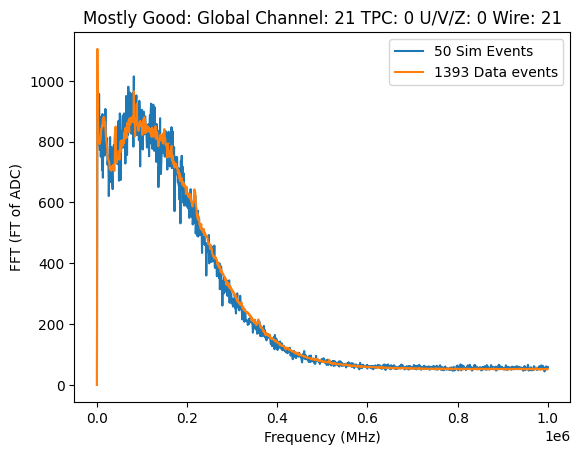

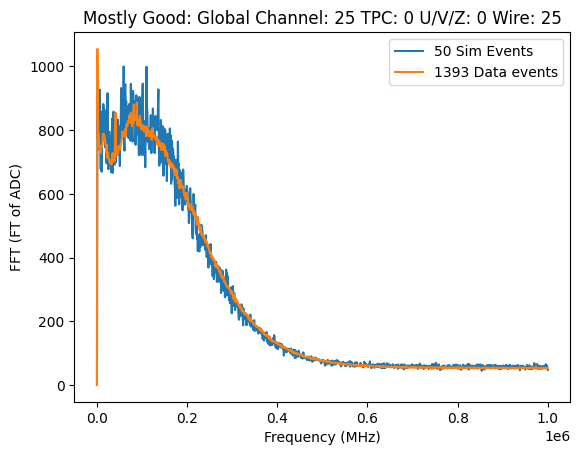

In [51]:
#Plot the first 10 Mostly Good Channels
MostlyGoodChannelsLocations = np.zeros((10,3),dtype=int)
for i in range(10):
    MostlyGoodChannelsLocations[i] = convert_index_to_sorted(np.where(MostlyGoodChannels==1)[0][i])

planenames = ["u", "v", "z"]

for i in range(10):
    fig = plt.figure()
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),AverageFFT[np.where(MostlyGoodChannels==1)[0][i]],label = "50 Sim Events")
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),FFT[np.where(MostlyGoodChannels==1)[0][i]],label = "1393 Data events")
    plt.title('Mostly Good: Global Channel: '+str(np.where(MostlyGoodChannels==1)[0][i]) + ' TPC: ' + str(MostlyGoodChannelsLocations[i][0]) + ' U/V/Z: ' + str(MostlyGoodChannelsLocations[i][1]) + ' Wire: ' + str(MostlyGoodChannelsLocations[i][2]))
    plt.xlabel('Frequency (MHz)')
    plt.ylabel('FFT (FT of ADC)')
    plt.legend()
    fig.savefig(str(np.where(MostlyGoodChannels==1)[0][i])+'.png', dpi = fig.dpi)

In [25]:
### Load and plot the full data noise model FFT
from Analyzer import Analyzer
from plotter import plotter
import numpy as np

##compare the data and simulation FFTs
AverageFFT = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/Sim_50_Plots_2/AverageFFT.npz')['FFT']
#FFT is the data FFT from the previous cell

NoiseModel = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/Data_Full_Plots/NoiseModel_FFT_05_15_2024.npz')
FFT = NoiseModel['PSD']

#FFT[240:280] = FFT[280:320]     #FEMB 9 u1 = FEMB 8 u1
#FFT[360:400] = FFT[280:320]     #FEMB 6 u1 = FEMB 8 u1
#FFT[600:640] = FFT[680:720]     #FEMB 6 v1 = FEMB 8 v1
#FFT[720:760] = FFT[680:720]     #FEMB 9 v1 = FEMB 8 v1
#FFT[1088:1136] = FFT[1136:1184] #FEMB 9 z1 = FEMB 8 z1
#FFT[1232:1280] = FFT[1136:1184] #FEMB 6 z1 = FEMB 8 z1

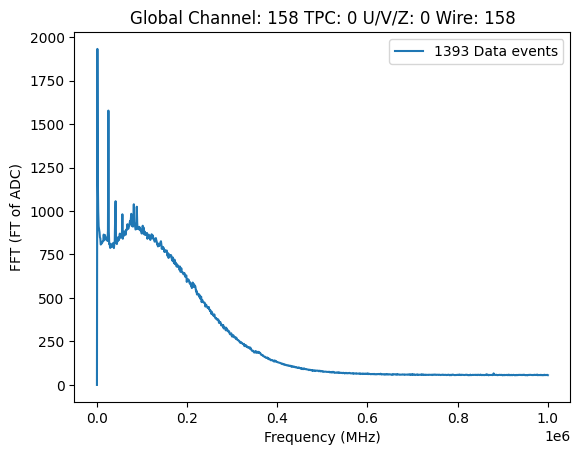

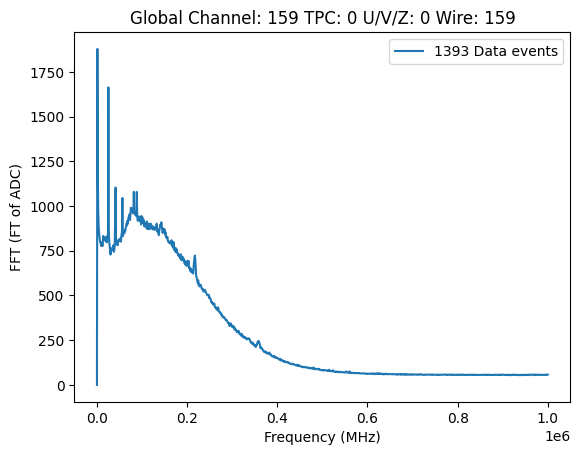

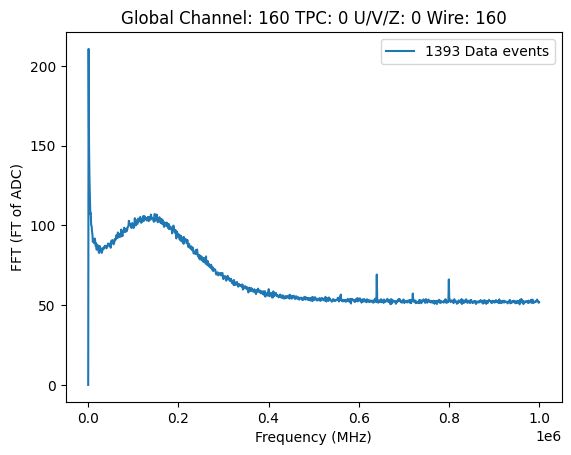

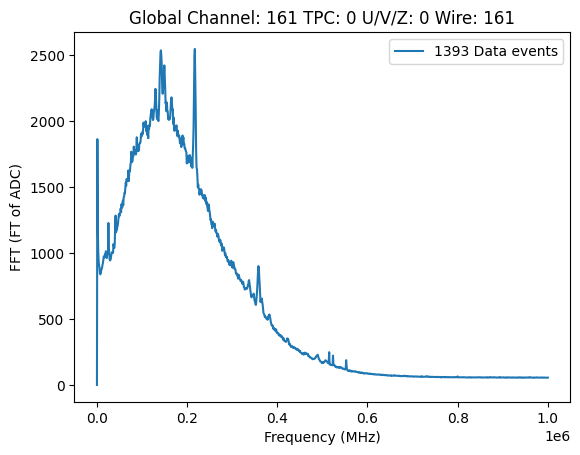

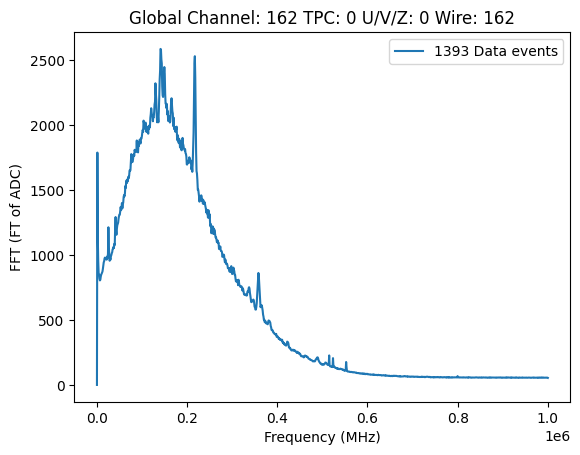

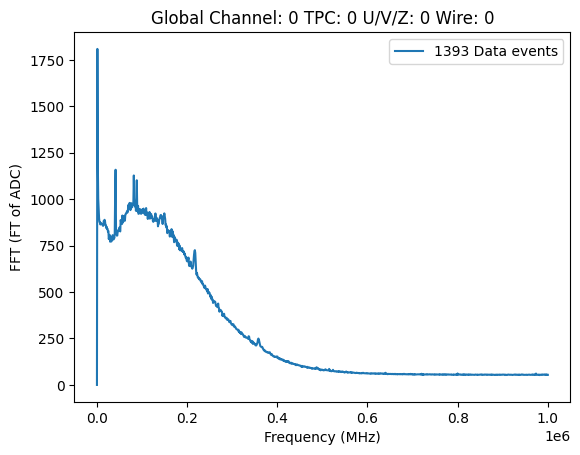

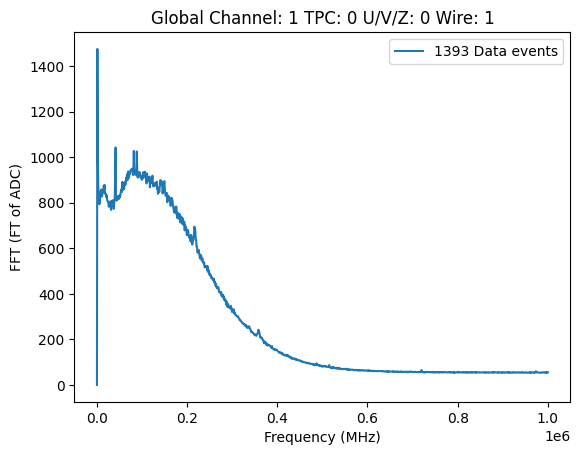

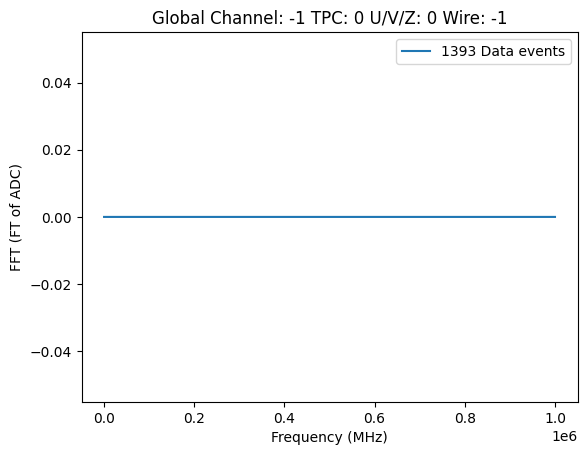

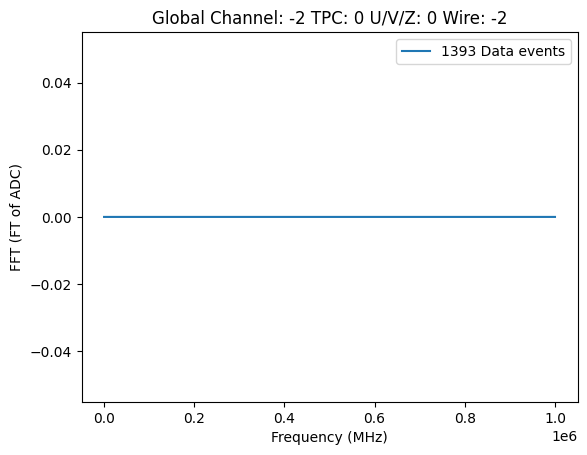

In [26]:
#### Here we check if there is an off-by-one error in the channel mapping
import matplotlib.pyplot as plt

channels_to_investigate = [158,159,160,161,162,0,1,-1,-2]
channels_to_investigate_sorted = np.zeros((len(channels_to_investigate),3),dtype=int)
for i in range(len(channels_to_investigate)):
    channels_to_investigate_sorted[i] = plotter.convert_index_to_sorted(channels_to_investigate[i])

planenames = ["u", "v", "z"]

for i in range(len(channels_to_investigate)):
    fig = plt.figure()
    plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),FFT[channels_to_investigate[i]],label = "1393 Data events")
    #plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),AverageFFT[channels_to_investigate[i]],label = "50 Sim Events")
    plt.title('Global Channel: '+str(channels_to_investigate[i]) + ' TPC: ' + str(channels_to_investigate_sorted[i][0]) + ' U/V/Z: ' + str(channels_to_investigate_sorted[i][1]) + ' Wire: ' + str(channels_to_investigate_sorted[i][2]))
    plt.xlabel('Frequency (MHz)')
    plt.ylabel('FFT (FT of ADC)')
    plt.legend()
    #fig.savefig(str(np.where(VeryBadChannels==1)[0][i])+'.png', dpi = fig.dpi)

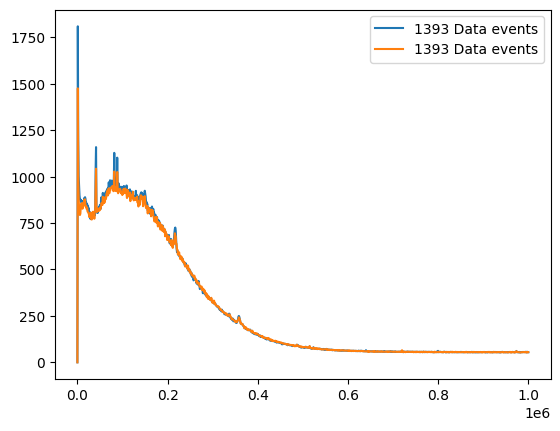

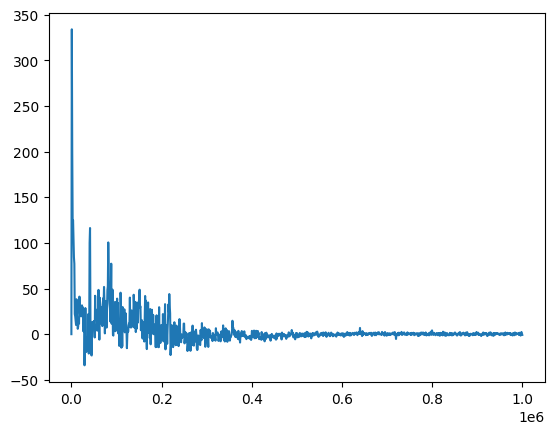

In [27]:
#Plot the first two data FFTs on top of each other and separately plot their difference
plt.figure()
plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),FFT[0],label = "1393 Data events")
plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),FFT[1],label = "1393 Data events")
plt.legend()

plt.figure()
plt.plot(np.fft.rfftfreq(plotter.minwvfm,plotter.SampleSpacing),FFT[0]-FFT[1],label = "1393 Data events")

Text(0, 0.5, 'Sum of FFT')

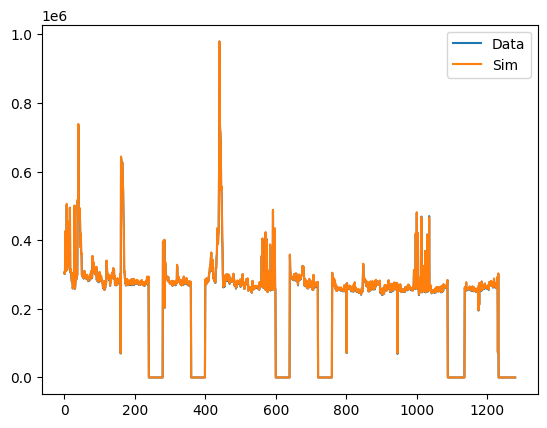

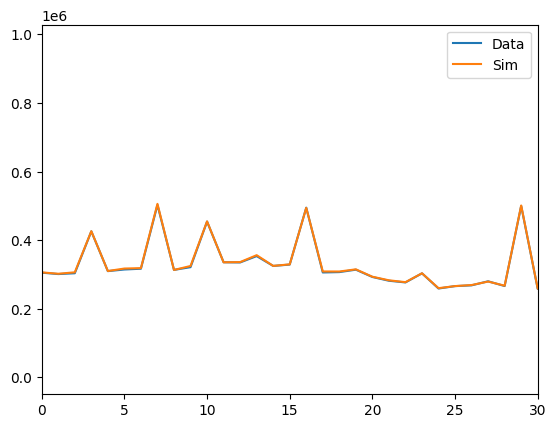

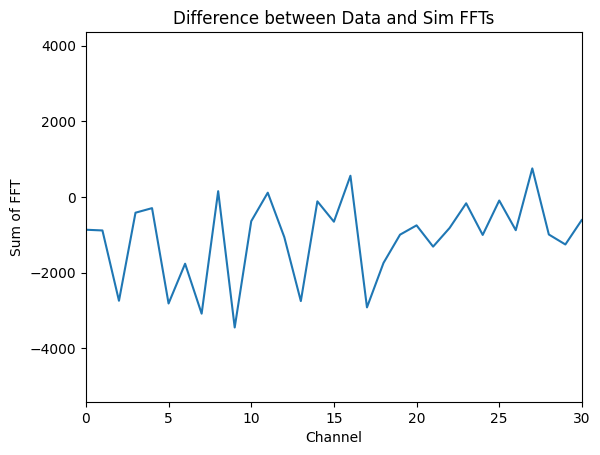

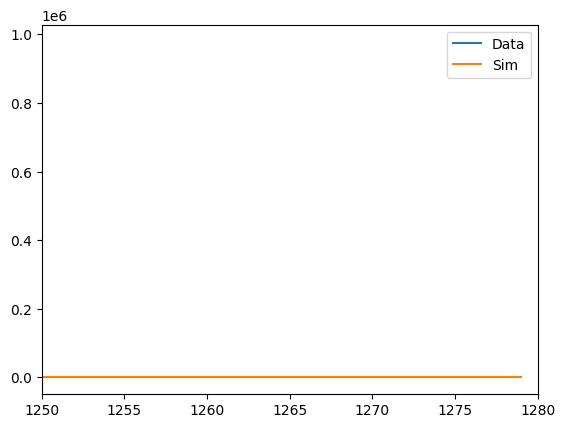

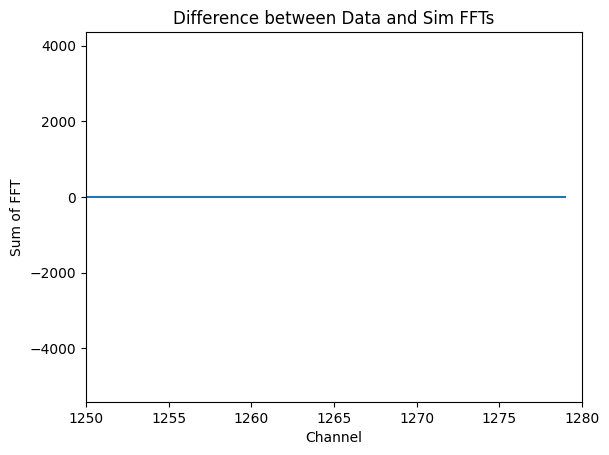

In [13]:
#For FFT and Average FFT, sum over all the frequency axis to create a numpy array with one entry per channel

FFT_sum = np.sum(FFT,axis=1)
AverageFFT_sum = np.sum(AverageFFT,axis=1)

plt.figure()
plt.plot(FFT_sum,label='Data')
plt.plot(AverageFFT_sum,label='Sim')
plt.legend()

plt.figure()
plt.plot(FFT_sum,label='Data')
plt.plot(AverageFFT_sum,label='Sim')
plt.xlim(0,30)
plt.legend()

#Plot the difference between the two
plt.figure()
plt.plot(FFT_sum-AverageFFT_sum)
plt.title('Difference between Data and Sim FFTs')
plt.xlim(0,30)
plt.xlabel('Channel')
plt.ylabel('Sum of FFT')

plt.figure()
plt.plot(FFT_sum,label='Data')
plt.plot(AverageFFT_sum,label='Sim')
plt.xlim(1250,1280)
plt.legend()

#Plot the difference between the two
plt.figure()
plt.plot(FFT_sum-AverageFFT_sum)
plt.title('Difference between Data and Sim FFTs')
plt.xlim(1250,1280)
plt.xlabel('Channel')
plt.ylabel('Sum of FFT')



In [12]:
##Plot some waveforms
##Overlay simulation on data

from Analyzer import Analyzer
import numpy as np
import uproot as uproot

datapath = '/exp/dune/data/users/mking/'
inputsimwaveformlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/05_15_2024_2/'
inputsimfilename = 'Waveforms_Sim.root'
inputdatawaveformlocation = 'ICEBERG_Data/ICEBERG_Run5_TH2F/'
inputdatafilename = 'Waveforms_Data_Run_9701.root'

Sim_Waveform_File_Path = datapath + inputsimwaveformlocation + inputsimfilename
Data_Waveform_File_Path = datapath + inputdatawaveformlocation + inputdatafilename

sim_infile = uproot.open(Sim_Waveform_File_Path)
data_infile = uproot.open(Data_Waveform_File_Path)
    

In [13]:
Sim, xedgessim, yedgessim = sim_infile['run_1_sub_0_event_1_daq;1'].to_numpy()
Sim_subtr = Sim - np.mean(Sim[:,0:2128],axis=1)[:,np.newaxis]

Data, xedgesdata, yedgesdata = data_infile['run_9701_sub_1_event_1_daq;1'].to_numpy()
#Exclude last column of Data because it's all zeros
Data_subtr = Data - np.mean(Data[:,0:2127],axis=1)[:,np.newaxis]
Data_subtr[:,2127] = np.zeros(1280)

timeticks = yedgessim[:-1]

In [50]:
#Plot the last waveform for simulation and for data

import matplotlib.pyplot as plt

plt.figure()
plt.plot(timeticks,Sim_subtr[100])
plt.title('Simulation Waveform')
plt.xlabel('Time (ns)')
plt.ylabel('ADC')
#plt.savefig('Sim_Waveform.png')

plt.figure()
plt.plot(timeticks,Data_subtr[100])
plt.title('Data Waveform')
plt.xlabel('Time (ns)')
plt.ylabel('ADC')
#plt.savefig('Data_Waveform.png')


TypeError: list indices must be integers or slices, not tuple

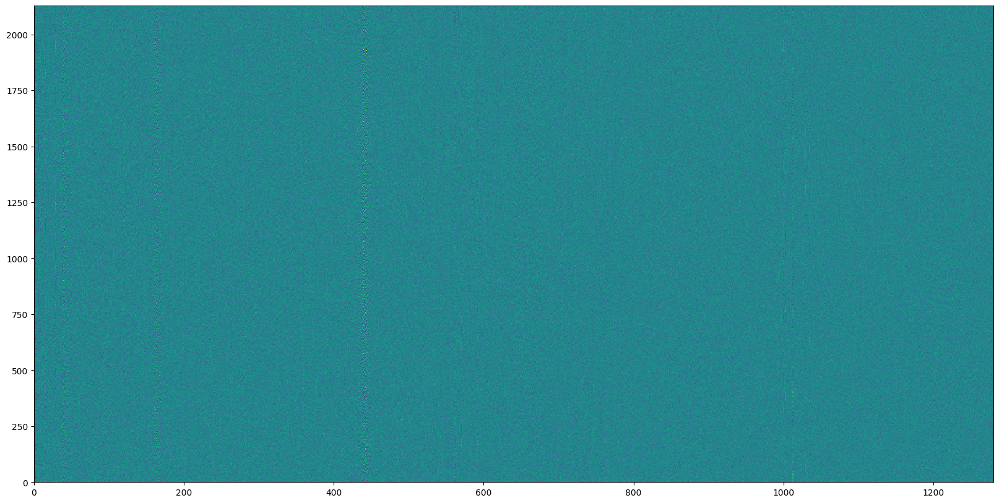

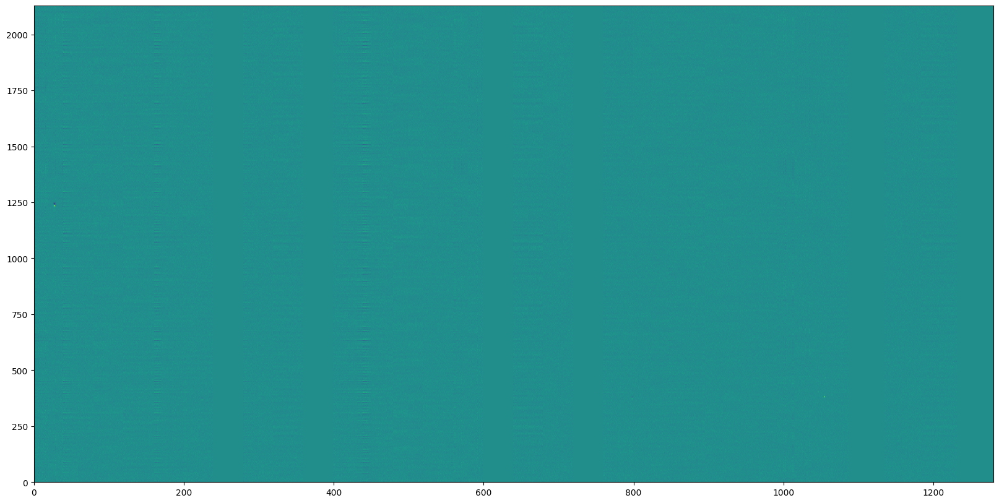

In [14]:
import matplotlib.pyplot as plt
fig2,ax2 = plt.subplots(1,figsize=(20,10))
pc2 = ax2.pcolorfast(xedgessim,yedgessim,Sim_subtr.T)
#plt.xlim(2080,2105)
#plt.ylim(1140,1220)
#fig2.savefig("Single_Sim_Waveform_Unsorted", dpi = fig2.dpi)
plt.show()

fig,ax = plt.subplots(1,figsize=(20,10))
pc = ax.pcolorfast(xedgesdata,yedgesdata,Data_subtr.T)
plt.show()

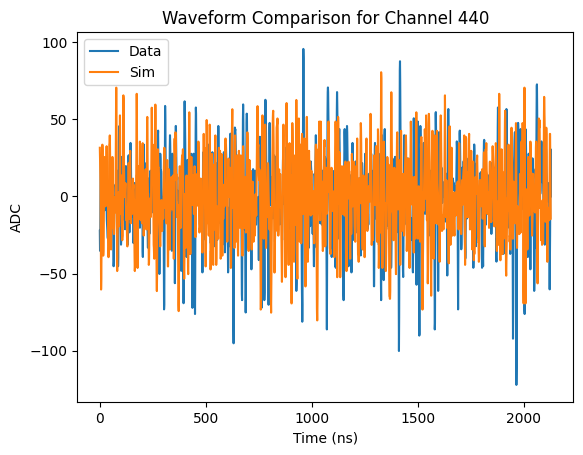

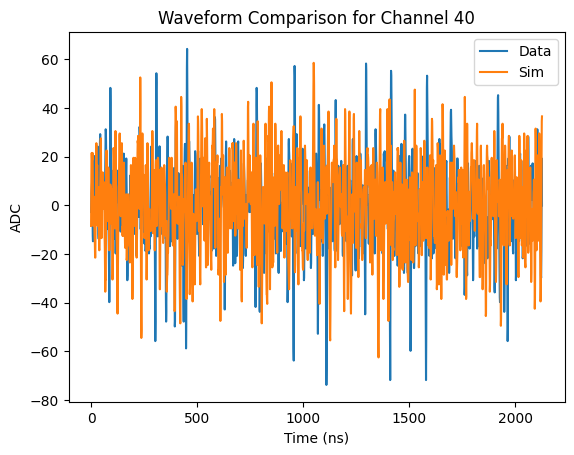

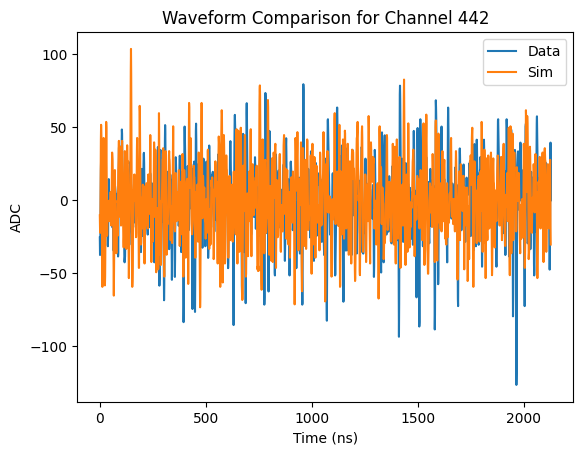

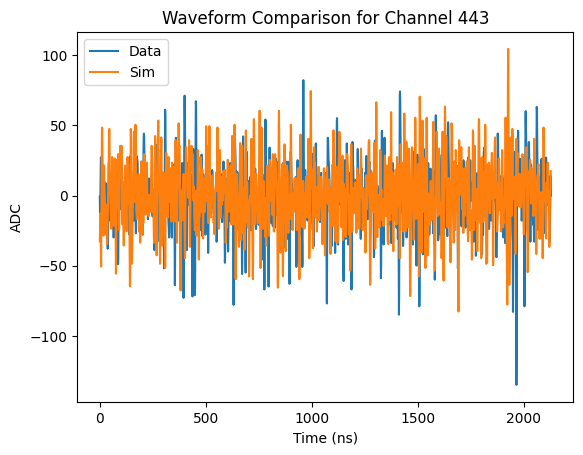

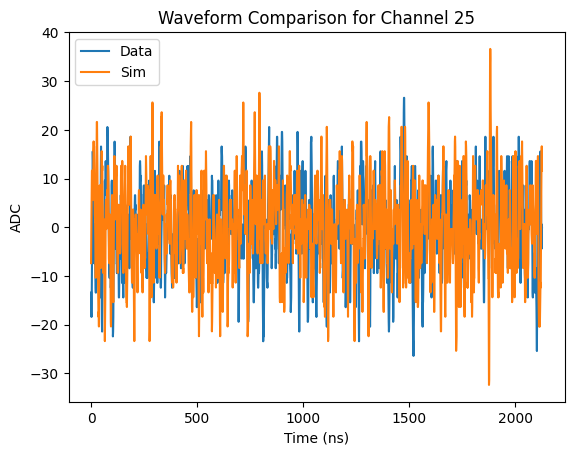

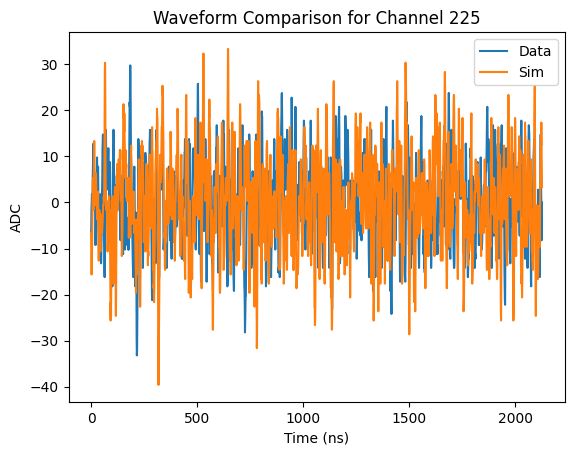

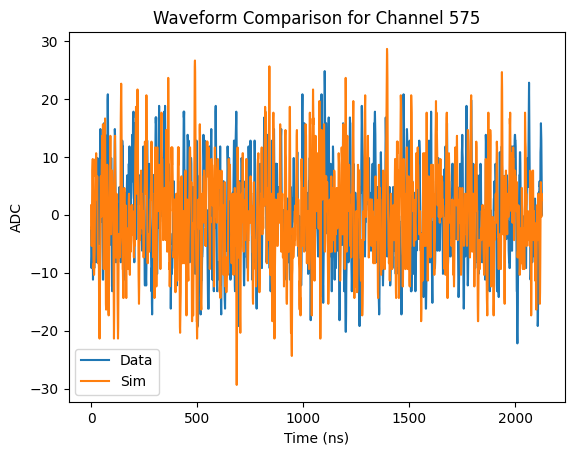

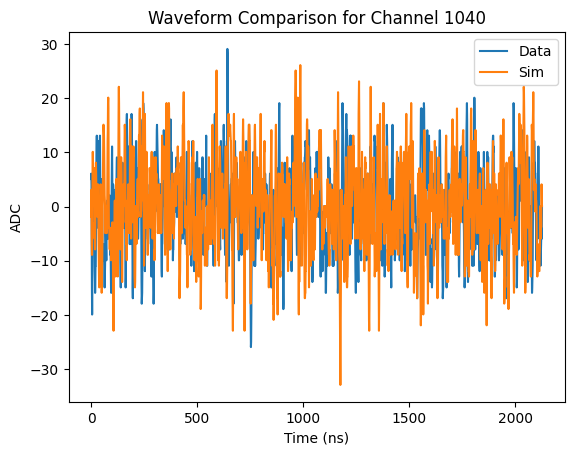

In [23]:
#indices = [-5,-4,-3,-2,-1,0,1,2]

indices = np.concatenate((np.array(ProblemChannelsCountSorted20)[:,0],GoodChannels))


for i in indices:
    plt.figure()
    plt.title('Waveform Comparison for Channel '+str(i))
    plt.plot(timeticks,Data_subtr[i],label='Data')
    plt.plot(timeticks,Sim_subtr[i],label='Sim')
    plt.xlabel('Time (ns)')
    plt.ylabel('ADC')
    plt.legend()
    plt.savefig('Waveform_Comparison_'+str(i)+'.png')

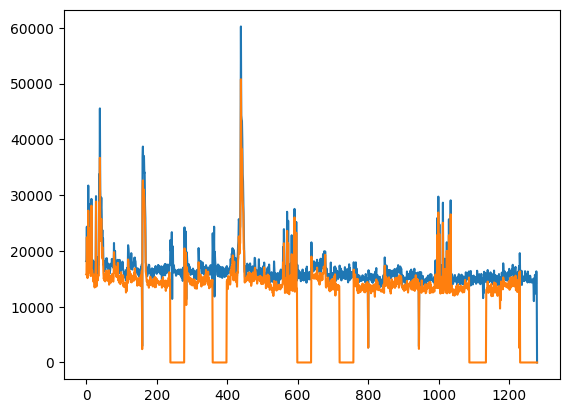

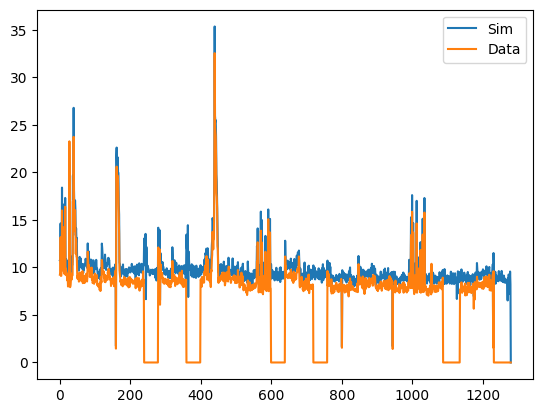

In [35]:
#Compute RMS of adc value for each channel, result should be a numpy array with one entry per channel
Sim_rms = np.sqrt(np.mean(Sim_subtr**2,axis=1))
Data_rms = np.sqrt(np.mean(Data_subtr**2,axis=1))

Sim_sum = np.sum(np.abs(Sim_subtr),axis=1)
Data_sum = np.sum(np.abs(Data_subtr),axis=1)

plt.figure()
plt.plot(Sim_sum,label='Sim')
plt.plot(Data_sum,label='Data')

plt.figure()
plt.plot(Sim_rms,label='Sim')
plt.plot(Data_rms,label='Data')
plt.legend()

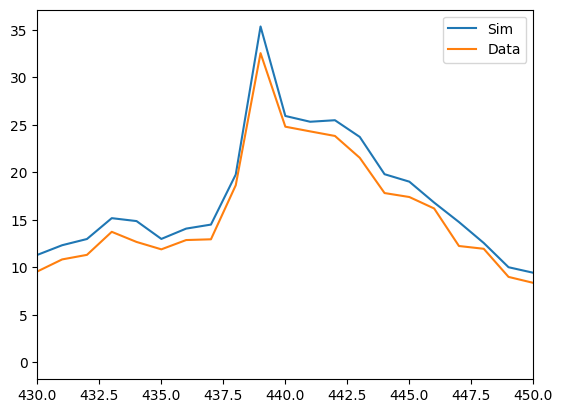

In [36]:
plt.figure()
plt.plot(Sim_rms,label='Sim')
plt.plot(Data_rms,label='Data')
plt.xlim(430,450)
plt.legend()

Text(0, 0.5, 'Sum of FFT')

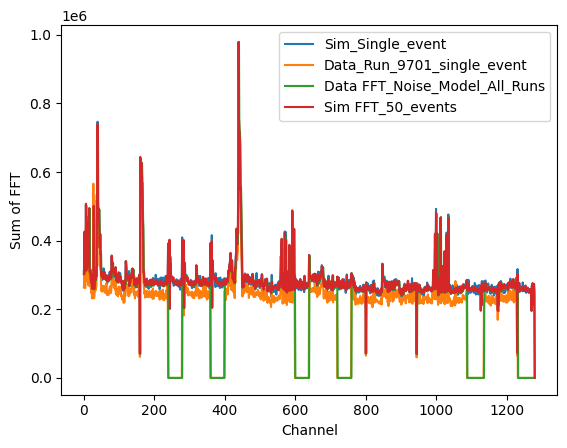

In [37]:
#Calculate the absolute value of the FFT for Sim and Data for each channel
#Then sum over the frequency values to get a numpy array with one entry per channel
#Plot these two on the same plot as FFT_sum and AverageFFT_sum

Sim_FFT = np.abs(np.fft.rfft(Sim_subtr))
Data_FFT = np.abs(np.fft.rfft(Data_subtr))

Sim_FFT_sum = np.sum(Sim_FFT,axis=1)
Data_FFT_sum = np.sum(Data_FFT,axis=1)

plt.figure()
plt.plot(Sim_FFT_sum,label='Sim_Single_event')
plt.plot(Data_FFT_sum,label='Data_Run_9701_single_event')
plt.plot(FFT_sum,label='Data FFT_Noise_Model_All_Runs')
plt.plot(AverageFFT_sum,label='Sim FFT_50_events')
plt.legend()
plt.xlabel('Channel')
plt.ylabel('Sum of FFT')


(230.0, 285.0)

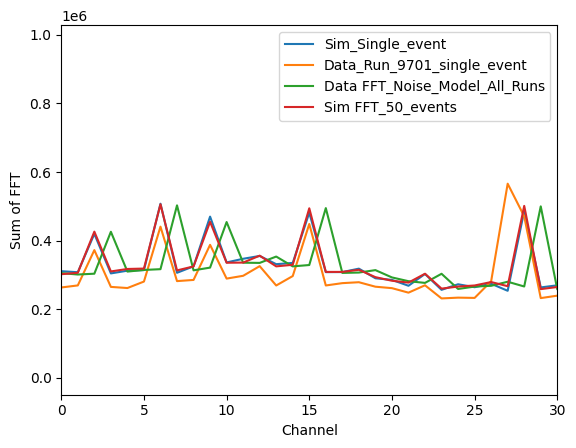

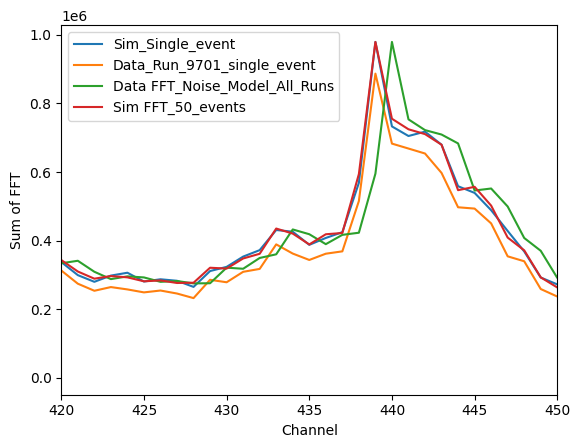

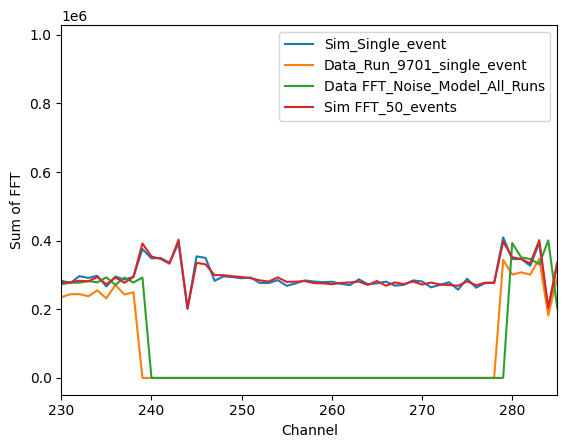

In [40]:
#Plot the same thing, but in different x limits

plt.figure()
plt.plot(Sim_FFT_sum,label='Sim_Single_event')
plt.plot(Data_FFT_sum,label='Data_Run_9701_single_event')
plt.plot(FFT_sum,label='Data FFT_Noise_Model_All_Runs')
plt.plot(AverageFFT_sum,label='Sim FFT_50_events')
plt.legend()
plt.xlabel('Channel')
plt.ylabel('Sum of FFT')
plt.xlim(0,30)

plt.figure()
plt.plot(Sim_FFT_sum,label='Sim_Single_event')
plt.plot(Data_FFT_sum,label='Data_Run_9701_single_event')
plt.plot(FFT_sum,label='Data FFT_Noise_Model_All_Runs')
plt.plot(AverageFFT_sum,label='Sim FFT_50_events')
plt.legend()
plt.xlabel('Channel')
plt.ylabel('Sum of FFT')
plt.xlim(420,450)

plt.figure()
plt.plot(Sim_FFT_sum,label='Sim_Single_event')
plt.plot(Data_FFT_sum,label='Data_Run_9701_single_event')
plt.plot(FFT_sum,label='Data FFT_Noise_Model_All_Runs')
plt.plot(AverageFFT_sum,label='Sim FFT_50_events')
plt.legend()
plt.xlabel('Channel')
plt.ylabel('Sum of FFT')
plt.xlim(230,285)

257
256
(1280,)


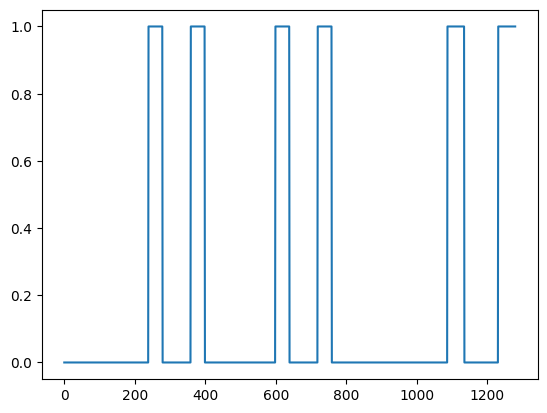

In [45]:
#Count number of zero entries in Data_FFT_Sum:
NumZeroEntries = np.sum(Data_FFT_sum == 0)
print(NumZeroEntries)
print(40*4+48*2)

plt.figure()
plt.plot(Data_FFT_sum==0)

print(np.shape(Data_FFT_sum))